## Processing Ocean Color Imagery

This data was collected in a mapping fashion with a constant viewing geometry of 40 and 135

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import geopandas as gpd
import pandas as pd


import os, glob
import multiprocessing
import math

#import cv2
import numpy as np
import matplotlib.pyplot as plt

#import exiftool
import datetime

import rasterio

from utils import *
from georeg import *

In [3]:
data_dir = os.path.join('data', '20210427_gulf_stream_surveys', 'flight3')
data_dir

'data/20210427_gulf_stream_surveys/flight3'

In [29]:
#grab last 4 characters of the file name:
def last_10chars(x):
    return(x[-10:])

img_fns = glob.glob(data_dir + '/sea' + "/*.tif")

img_fns = sorted(img_fns, key = last_10chars)
len(img_fns)

2436

In [4]:
! ls data/20210427_gulf_stream_surveys/flight3

all_imgs  sea			     SYNLog-15-39-22_27-04-2021.csv
chla	  sea_stacks_with_panel      SYNLog-15-39-22_27-04-2021_edit.csv
panel	  sea_thumbnails_with_panel
rededge   sky


In [5]:
data_dir

'data/20210427_gulf_stream_surveys/flight3'

In [6]:
alta_logs = format_alta_logs(data_dir + '/SYNLog-15-39-22_27-04-2021_edit.csv')
alta_logs.head()

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3347: DtypeWarning: Columns (0,1,2,4,5,6,7,9) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


,Reading,IMU Time,Date,GPS Time,Unnamed: 4,Longitude,Latitude,GPS Height,GPS Course,GPS Pos N,...,Gyro Bias P,Gyro Bias Y,Accel Bias X,Accel Bias Y,Accel Bias Z,Extended Status,5V Alarm,Z Vibration,Checksum,id
dt,,,,,,,,,,,,,,,,,,,,,
2021-04-27 15:39:22.000000,26,1.004,20210427,15:39:22,NaN,-761617536,340383296,1.73,6.8,66.7,...,-40.6960,6.7062,0.015,0.033,0.291,0.0,0.0,0.10,34.0,0
2021-04-27 15:39:22.000001,27,1.044,20210427,15:39:22,NaN,-761617536,340383296,1.73,6.8,66.7,...,-40.6891,6.7069,0.017,0.037,0.291,0.0,0.0,0.10,254.0,1
2021-04-27 15:39:22.000002,28,1.084,20210427,15:39:22,NaN,-761617536,340383296,1.73,6.8,66.7,...,-40.6882,6.7131,0.019,0.042,0.290,0.0,0.0,0.09,178.0,2
2021-04-27 15:39:22.000003,29,1.124,20210427,15:39:22,NaN,-761617536,340383296,1.73,6.8,66.7,...,-40.6923,6.7133,0.021,0.047,0.290,0.0,0.0,0.09,91.0,3
2021-04-27 15:39:22.000004,30,1.164,20210427,15:39:22,NaN,-761617536,340383296,1.73,6.8,66.7,...,-40.6945,6.7218,0.022,0.052,0.290,0.0,0.0,0.09,63.0,4


In [7]:
sky_dir = os.path.join(data_dir, 'sky', 'stacks')
surface_dir = os.path.join(data_dir, 'sea', 'stacks')

In [8]:
10,-31

(10, -31)

In [9]:
len(mds)

NameError: name 'mds' is not defined

In [10]:
start = 10
count = 45 # 479-51-18
sea_imgs, sea_img_metadata = retrieve_imgs_and_metadata(surface_dir, count=count, start=start, altitude_cutoff=0)

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


In [11]:
sea_imgs.shape

(45, 6, 1470, 2021)

Find the closest row in the flight logs based on time stamp and add the more accurate yaw

In [30]:
for item in sea_img_metadata:
    utc_time = datetime.datetime.strptime('2021-04-27-' + item['UTC-Time'], '%Y-%m-%d-%H:%M:%S')
    img_idx = alta_logs.index.get_loc(utc_time, method='nearest')
    item['log_id'] = img_idx
    item['alta_yaw'] = (alta_logs.iloc[img_idx]['Yaw'] + 360) % 360
    # then ensures
    item['image_name'] = img_fns[start*6+item['id']*6]

In [29]:
sky_imgs, sky_img_metadata = retrieve_imgs_and_metadata(sky_dir, count=10, start=10, altitude_cutoff=0)

In [30]:
sky_imgs.shape

(10, 6, 1474, 2030)

In [31]:
blocked_dir = os.path.join(data_dir, 'rededge', 'tube', 'stacks')
blocked_dir

'data/20210427_gulf_stream_surveys/flight3/rededge/tube/stacks'

In [49]:
blocked_imgs, blocked_img_metadata = retrieve_imgs_and_metadata(blocked_dir, count=20, start=0, altitude_cutoff=0)

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


In [13]:
sky_dir_re = os.path.join('data', '20210407_duml_full_workflow_test', 'sky_rededge', 'stacks')
surface_dir_re = os.path.join('data', '20210407_duml_full_workflow_test', 'sea_rededge', 'stacks')

In [14]:
sky_re_imgs, sky_re_img_metadata = retrieve_imgs_and_metadata(sky_dir_re, count=100, start=0, altitude_cutoff=0)
sea_re_imgs, sea_re_img_metadata = retrieve_imgs_and_metadata(surface_dir_re, count=100, start=0, altitude_cutoff=0)

Output shape is:  (4, 5, 946, 1267)
Output shape is:  (9, 5, 946, 1267)


only grab metadata

Open the md of each image and then sort by time and then I know the order of pitch

then I can sort by pitch and yaw

In [15]:
band_names = ['blue', 'green', 'red', 'red edge', 'nir']

In [33]:
mds = load_img_fn_and_meta(surface_dir, start=0)
len(mds)

407

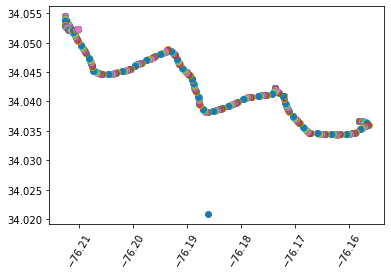

In [11]:
for md in mds:
    plt.scatter(md['Longitude'],md['Latitude'])
    plt.xticks(rotation=60)

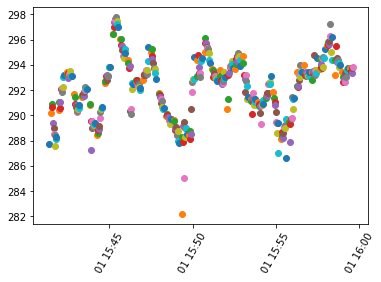

In [18]:
for md in mds[10:]:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['yaw'])
    plt.xticks(rotation=60)

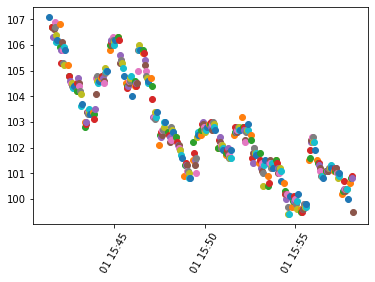

In [22]:
for md in mds[10:-31]:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['Altitude'])
    plt.xticks(rotation=60)

In [38]:
from datetime import datetime
chla_dates = []
for im in sea_img_metadata:
    date_time_str = im['Date'] + ' ' + im['UTC-Time']

    date_time_obj = datetime.strptime(date_time_str, '%m/%d/%Y %H:%M:%S')
    chla_dates.append(date_time_obj)

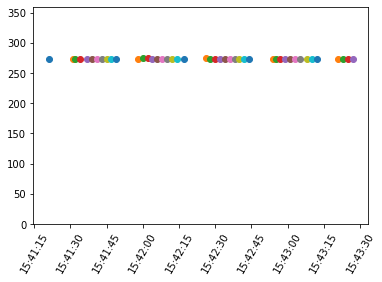

In [33]:
import datetime

for md in sea_img_metadata:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['alta_yaw'])
    plt.xticks(rotation=60)
    plt.ylim(0,360)

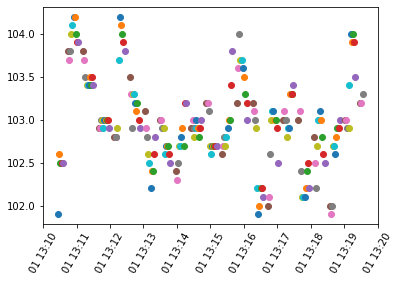

In [24]:
import datetime

for md in mds[84:]:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['Altitude'])
    plt.xticks(rotation=60)

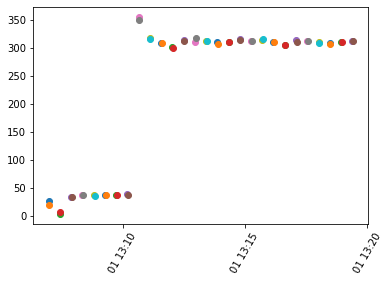

In [13]:
for md in mds:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['pitch'])
    plt.xticks(rotation=60)

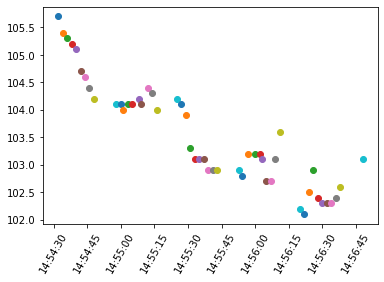

In [42]:
for md in sea_img_metadata:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['Altitude'])
    plt.xticks(rotation=60)

In [17]:
sea_imgs.nbytes / 1e9

8.5561056

In [18]:
sky_imgs.nbytes / 1e9

2.1422016

Inspect a couple images

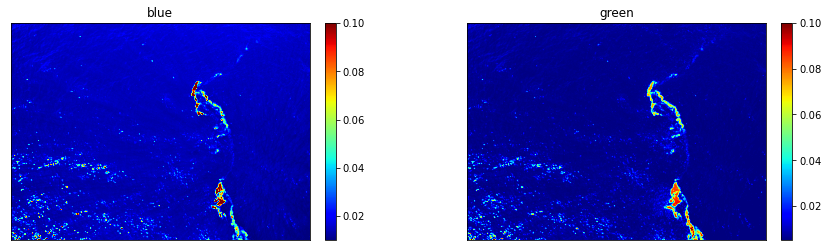

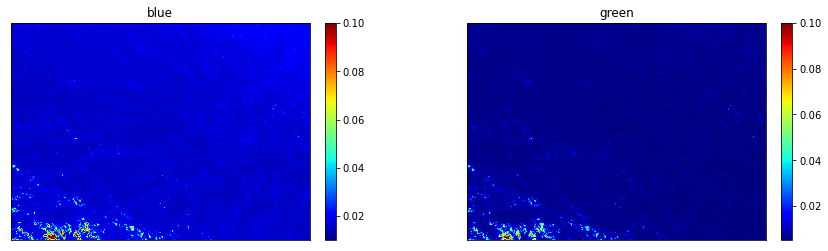

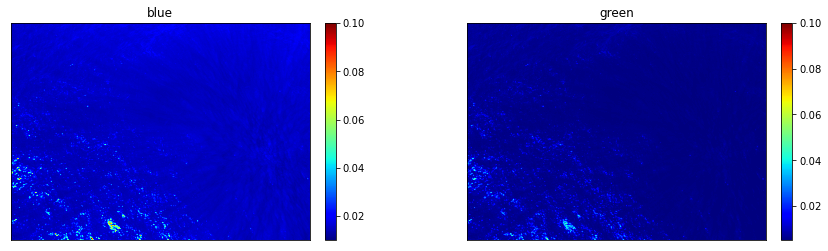

In [16]:
for i in [5,15,25]:
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(sea_imgs[i,0],cmap='jet', vmin=0.01, vmax=.1)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(sea_imgs[i,1],cmap='jet', vmin=0.005, vmax=.1)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()

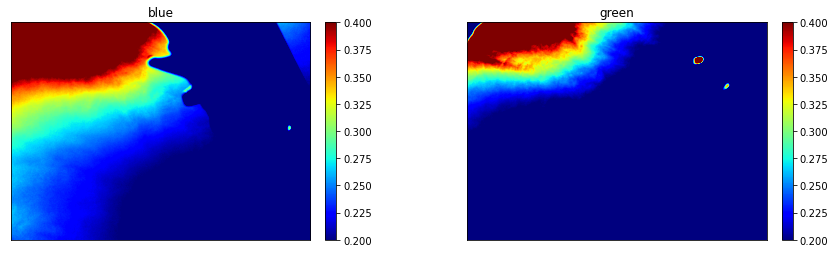

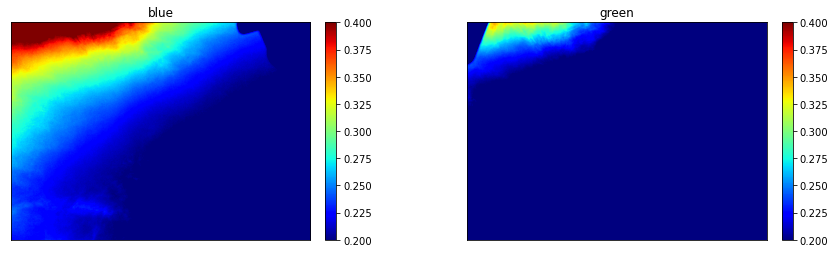

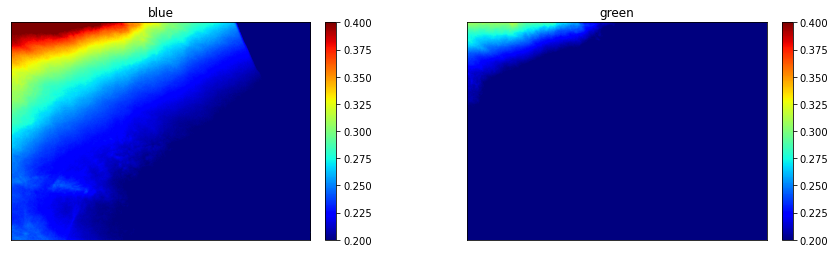

In [36]:
for i in [0,5,7]:
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(sky_imgs[i,0],cmap='jet', vmin=0.2, vmax=.4)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(sky_imgs[i,1],cmap='jet', vmin=0.2, vmax=.4)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()

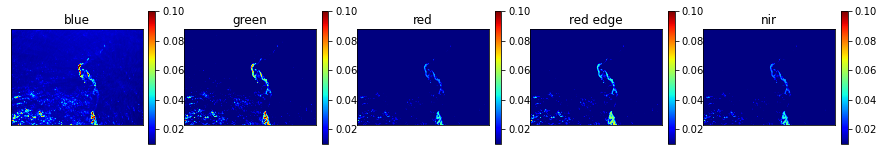

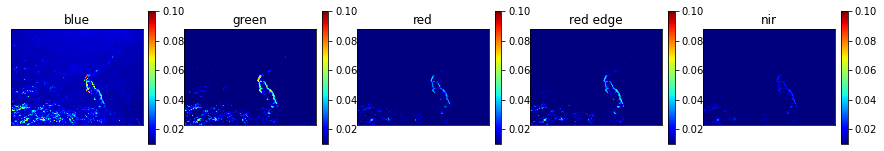

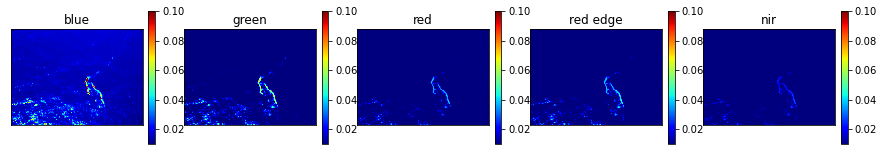

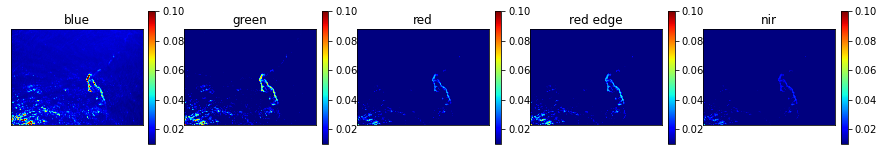

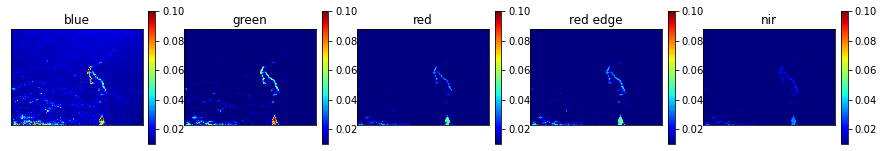

...

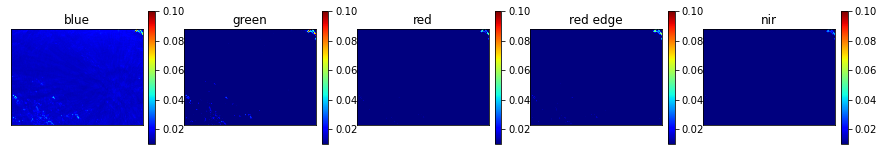

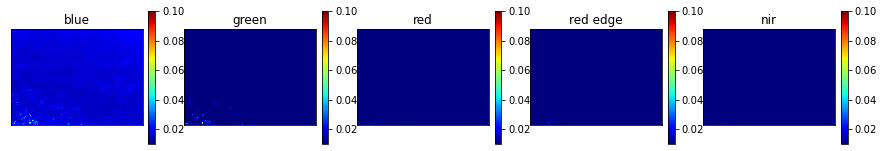

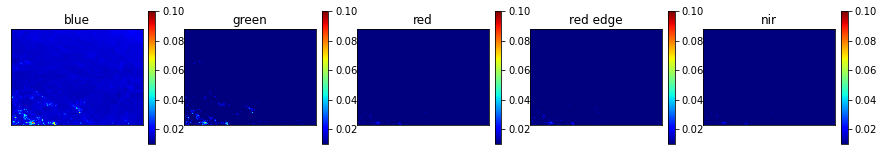

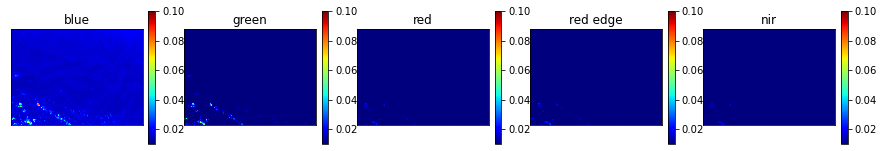

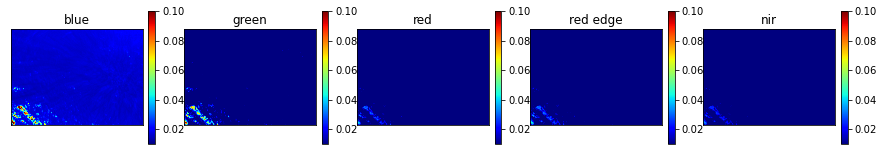

In [17]:
for j in range(0,15):
    fig, ax = plt.subplots(1,5, figsize=(15,4))
    for i in range(5):
        im = ax[i].imshow(sea_imgs[j,i],cmap='jet', vmin=0.01, vmax=.1)
        fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        ax[i].set_title(band_names[i])

Visualize some stacked RGB images

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


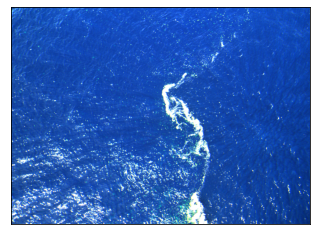

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


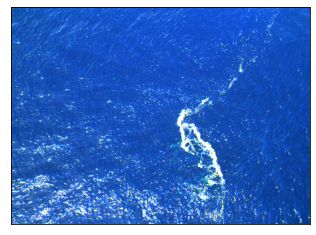

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


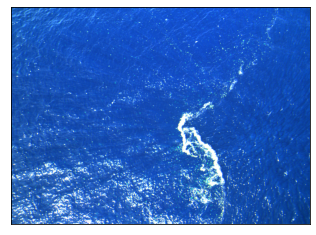

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


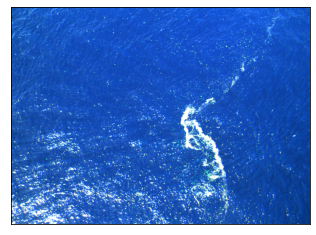

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


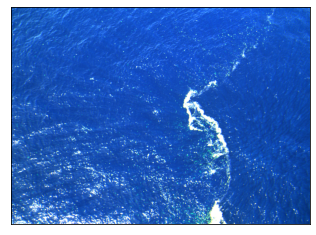

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


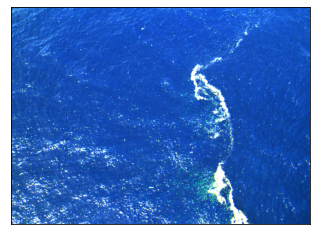

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


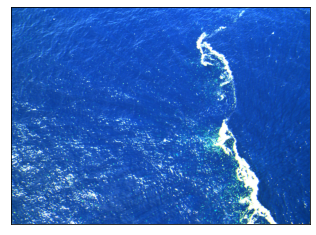

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


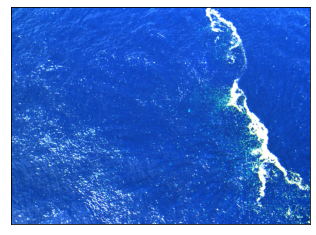

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


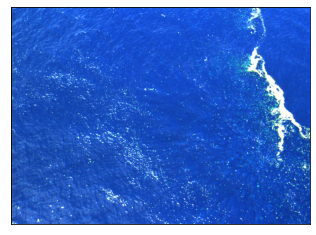

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


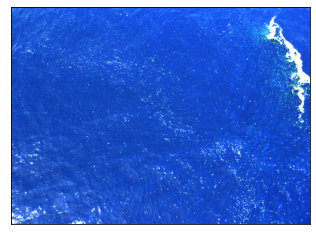

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


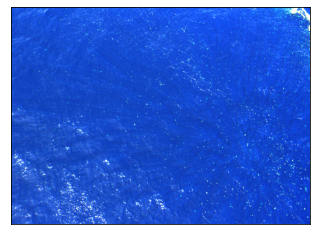

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


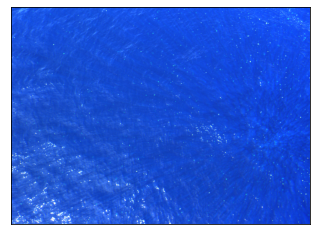

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


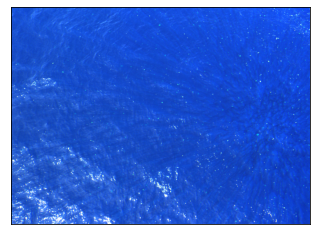

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


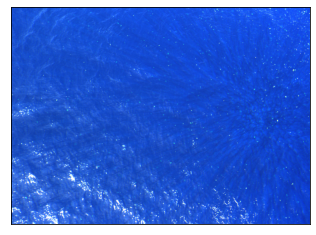

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


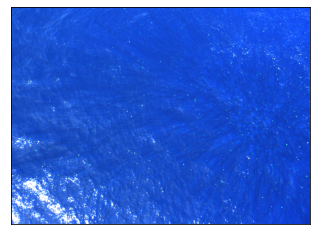

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


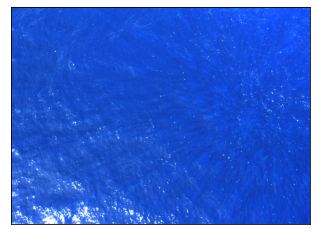

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


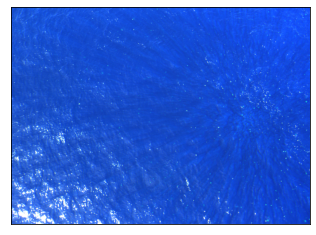

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


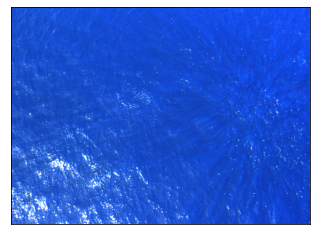

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


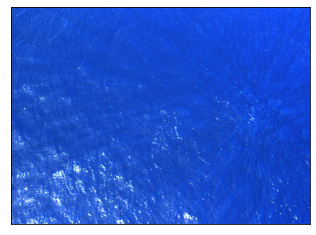

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


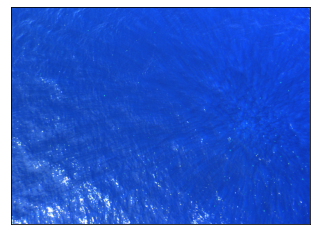

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


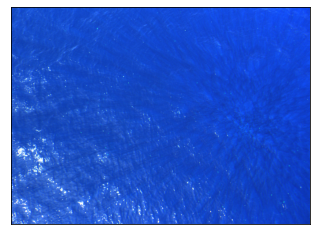

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


KeyboardInterrupt: 

In [19]:
for j in range(0,30):
    plt.imshow((np.transpose(sea_imgs[j,0:3]/0.02, (1,2,0))[:,:,::-1]))
    plt.xticks([])
    plt.yticks([])
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


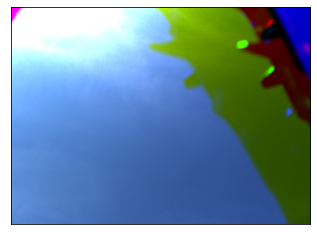

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


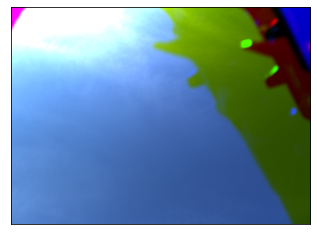

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


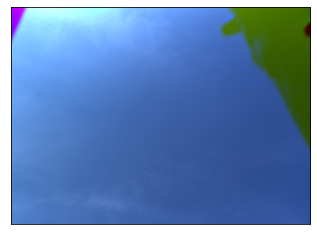

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


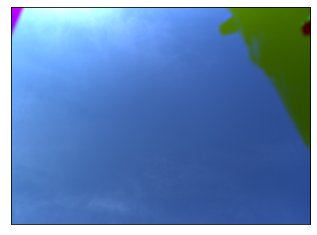

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


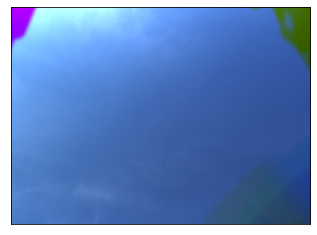

In [41]:
for j in range(0,5):
    plt.imshow((np.transpose(sky_imgs[j,0:3]/0.3, (1,2,0))[:,:,::-1]))
    plt.xticks([])
    plt.yticks([])
    plt.show()

### create medians of each image for correction

In [20]:
sea_imgs.shape

(45, 6, 1470, 2021)

In [21]:
sky_imgs.shape

NameError: name 'sky_imgs' is not defined

In [22]:
sea_median = np.median(sea_imgs[13:], axis=0)

In [45]:
sky_median = np.median(sky_imgs, axis=0)

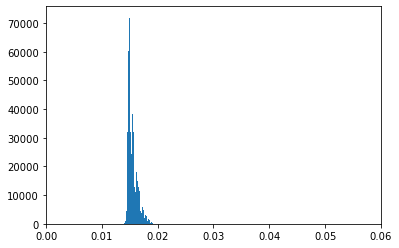

In [25]:
plt.hist(sea_median[0].flatten(), bins=300)
plt.xlim(0.00,0.06)
plt.show()

In [24]:
np.median(sea_median, axis=(1,2))

array([0.01527405, 0.00552368, 0.00146484, 0.00128174, 0.00090027,
       0.89936829])

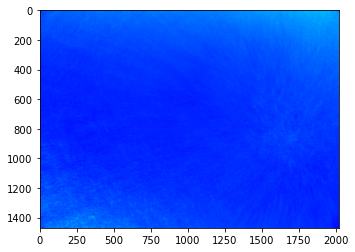

In [26]:
plt.imshow(sea_median[0], vmin=0.01,vmax=.04, cmap='jet')

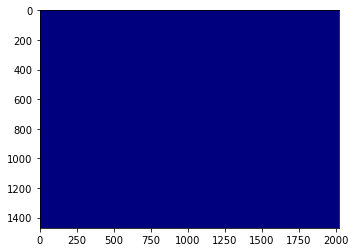

In [27]:
plt.imshow(sea_median[1], vmin=0.01,vmax=.04, cmap='jet')

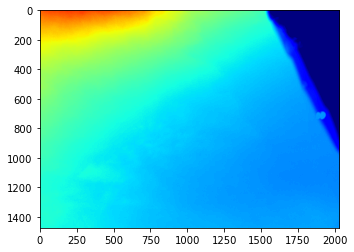

In [57]:
plt.imshow(sky_median[0], vmin=0.04,vmax=.55, cmap='jet')

#### inspect the sun blocked spectra based on the brightest pics there

In [58]:
blocked_imgs.shape

(19, 5, 945, 1268)

brightest pixels used: 23965
brightest pixels used: 23965
brightest pixels used: 23965
brightest pixels used: 23965
brightest pixels used: 23965
brightest pixels used: 23965
brightest pixels used: 23965
brightest pixels used: 23965
brightest pixels used: 23965
brightest pixels used: 23965


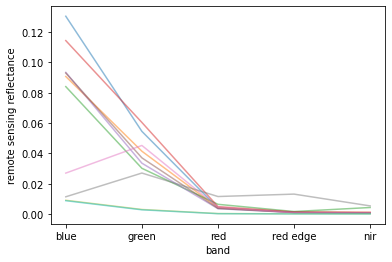

In [73]:
blocked_spectra = []
for i in range(5,15):
    spec = brightest_tube_pix(blocked_imgs[i], percent=0.02)
    plt.plot(band_names, spec, alpha=0.5)
    plt.ylabel('remote sensing reflectance')
    plt.xlabel('band')
    blocked_spectra.append(spec)
blocked_spectra = np.array(blocked_spectra)

brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198
brightest pixels used: 1198


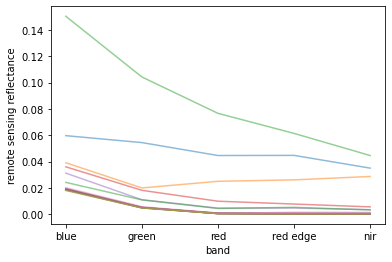

In [34]:
blocked_spectra = []
for i in range(0,blocked_imgs.shape[0]):
    spec = brightest_tube_pix(blocked_imgs[i], percent=0.001)
    plt.plot(band_names, spec, alpha=0.5)
    plt.ylabel('remote sensing reflectance')
    plt.xlabel('band')
    blocked_spectra.append(spec)
blocked_spectra = np.array(blocked_spectra)

In [35]:
0.03035012 / 0.00595001

5.100851931341292

In [36]:
0.020176/0.00536137

3.7632172373852204

In [70]:
median_blocked_spec = np.mean(blocked_spectra,axis=0)
median_blocked_spec

array([0.10901343, 0.05942154, 0.01017963, 0.00802368, 0.00525239])

In [74]:
median_blocked_spec[0]/median_blocked_spec[1]

1.8345778519555138

In [62]:
ci1 = -0.49
ci2 = 191.6590

# ci1 = -0.38152295986028695
# ci2 = 271.37634868

# average of 443*.5 + 489*1.5
# ci1 = -0.30002281538304754
# ci2 = 310.5772338

# ci1 = -0.21380600002416383
# ci2 = 572.01573044



def oc_index(blue, green, red):
    blue, green, red = blue/math.pi, green/math.pi, red/math.pi
    CI = green - ( blue + (555 - 477)/(667 - 477) * (red - blue) )
    
    #print(green)
    #print(( blue + (555 - 443)/(667 - 443) * (red - blue) ))
    
    #print(CI)

    ChlCI = 10**(ci1 + ci2*CI)
    return(ChlCI)

In [63]:
vec_chla_img(median_blocked_spec[0],median_blocked_spec[1])

0.7958060420663184

In [64]:
print('chla is: ', oc_index(median_blocked_spec[0],median_blocked_spec[1], median_blocked_spec[2]))

chla is:  0.09116707918998679


In [65]:
oc_index(0.01527405, 0.00552368, 0.00146484)

0.18239407945263184

Run through each image, subtract the blocked spectra, then find the average spectra, then run chla algorithm on it, then add it to list

### Correct for sun glint

### This is the current approach to calculating rho based on sunblocked spectra

Simple version

Take the blocked spectra and subtract that from Lt and then smooth that over and that is the correction to all the other images

Sea median - blocked_spectra is lsky * rho. So then to get Lw in the future all I need to do is subtract that from Lt

In [71]:
np.median(sea_median,axis=(1,2))

array([0.01527405, 0.00552368, 0.00146484, 0.00128174, 0.00090027,
       0.89936829])

In [72]:
np.median(blocked_spectra, axis=0)

array([0.14322414, 0.06901166, 0.00689046, 0.00211315, 0.00189085])

In [66]:
smoothed_lt_lw = ndimage.gaussian_filter(((sea_median[:5,:,:].T - np.median(blocked_spectra, axis=0)).T), sigma=(0, 10, 10), order=0)

Visualize the sea median bands

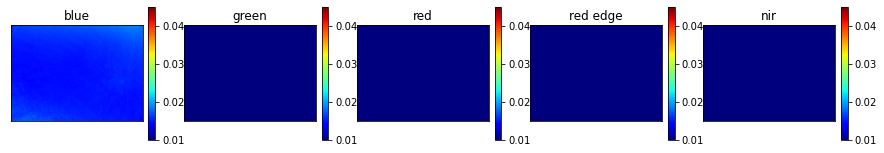

In [67]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sea_median[i],cmap='jet', vmin=0.01, vmax=.045)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Sea median images divided by image mean

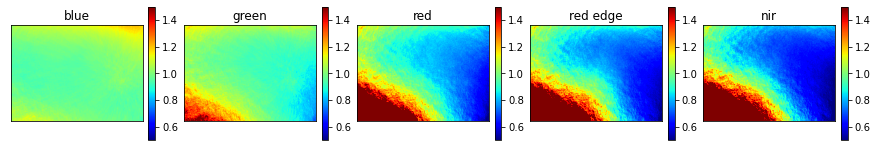

In [70]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sea_median[i]/np.mean(sea_median[i]),cmap='jet', vmin=0.5, vmax=1.5)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Sky median images

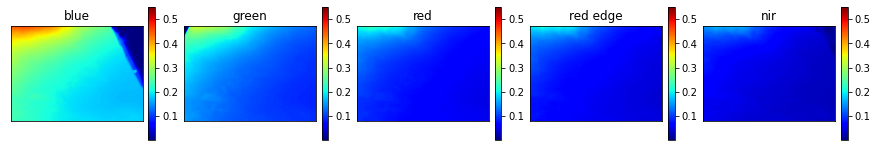

In [172]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sky_median[i],cmap='jet', vmin=0.003, vmax=.55)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

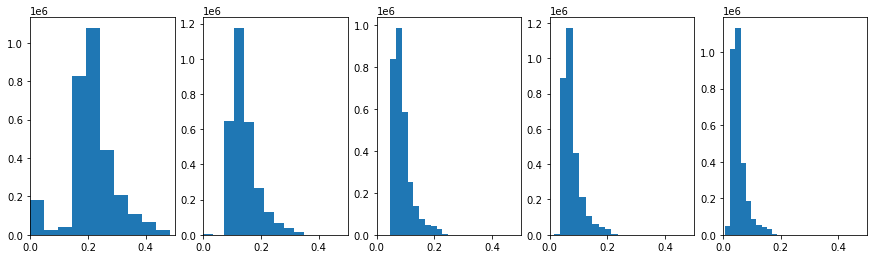

In [180]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    ax[i].hist(sky_median[i].flatten())
    ax[i].set_xlim(0,.5)

Sky median divided by the mean sky median

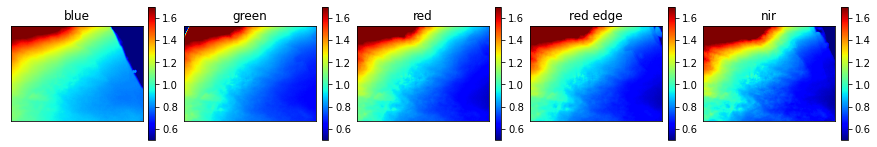

In [72]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sky_median[i]/np.mean(sky_median[i]),cmap='jet', vmin=.5, vmax=1.7)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Smoothed lt - lw images (aka rho*lsky)

***This is what will be subtracted from each image

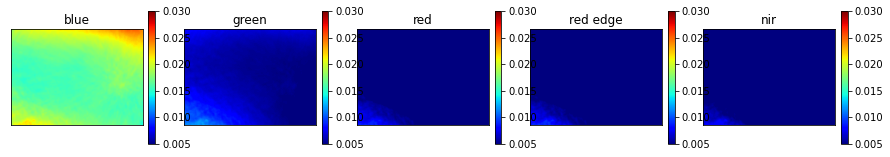

In [74]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i],cmap='jet', vmin=0.005, vmax=.03)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

lt - lw divided buy the mean of that

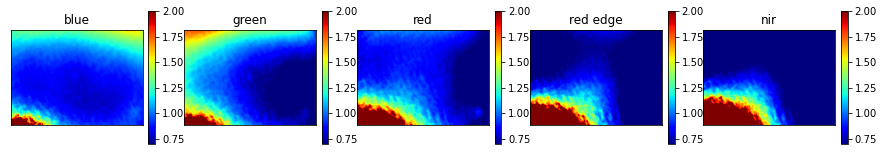

In [48]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i]/np.mean(smoothed_lt_lw[i]),cmap='jet', vmin=.7, vmax=2)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

lt-lw divided by lsky which is effectively rho

ValueError: operands could not be broadcast together with shapes (1470,2021) (1474,2021) 

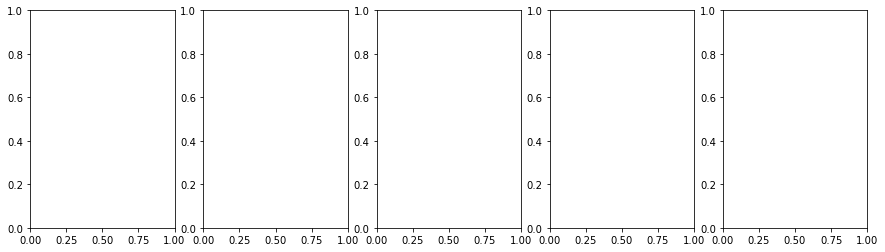

In [75]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i]/sky_median[i,::-1,:2021],cmap='jet', vmin=0.001, vmax=.2)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

### Apply simple approach

just take smoothed_lt_lw and subtract it from the lt images

First look at all bands

In [76]:
1

1

In [69]:
np.median(smoothed_lt_lw,axis=(1,2))

array([-0.12797492, -0.06348877, -0.00541506, -0.00083508, -0.00098475])

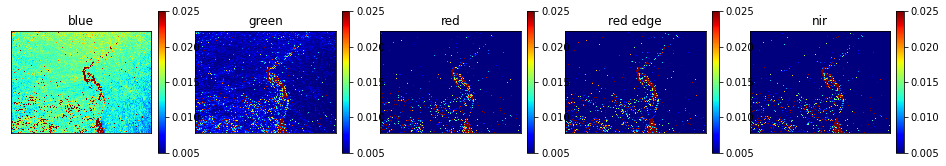

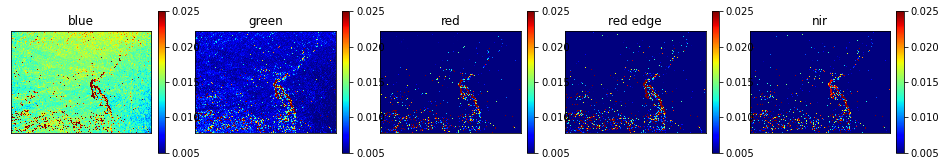

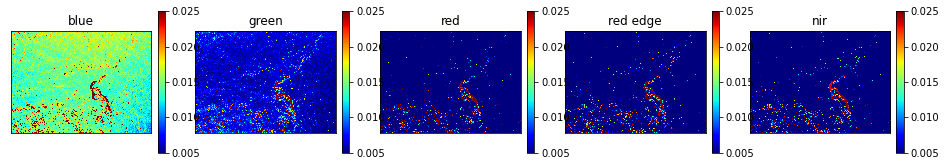

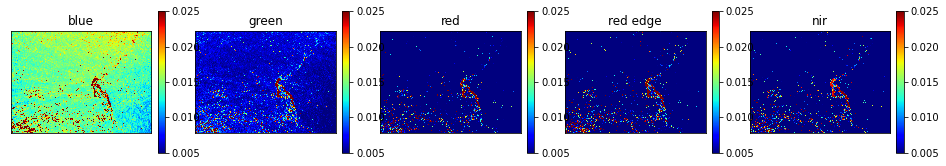

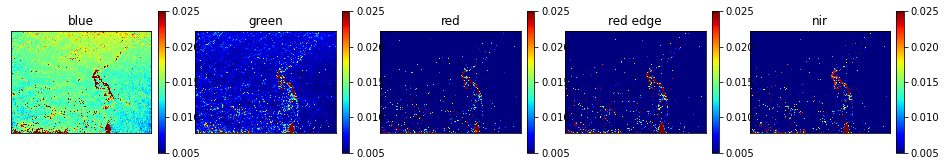

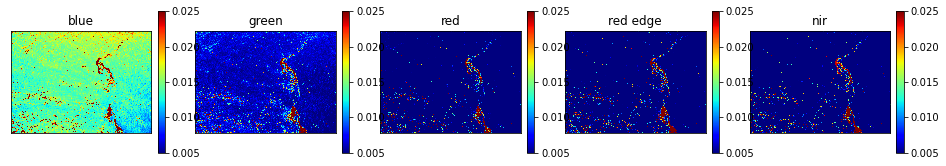

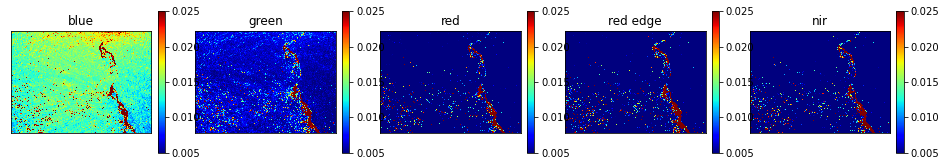

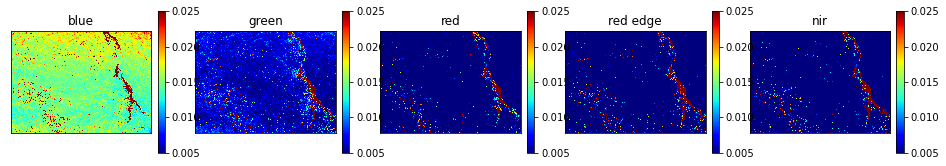

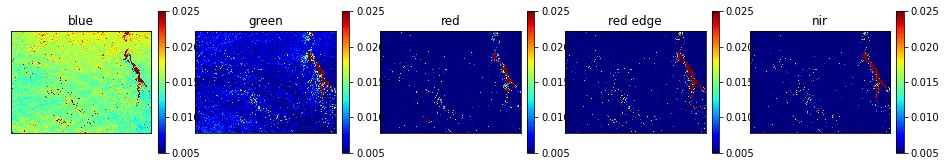

KeyboardInterrupt: 

In [80]:
for i in range(0,30):
    visualize_darkest_pixels(sea_imgs[i,:5], lowest_percent=1, max_clim=0.025, min_clim=0.005, only_img=True)

Now let's look at before and after with blue and green bands

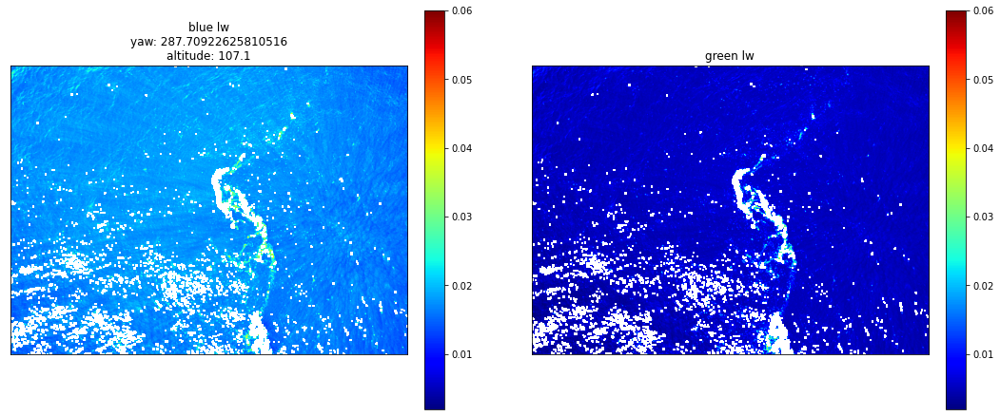

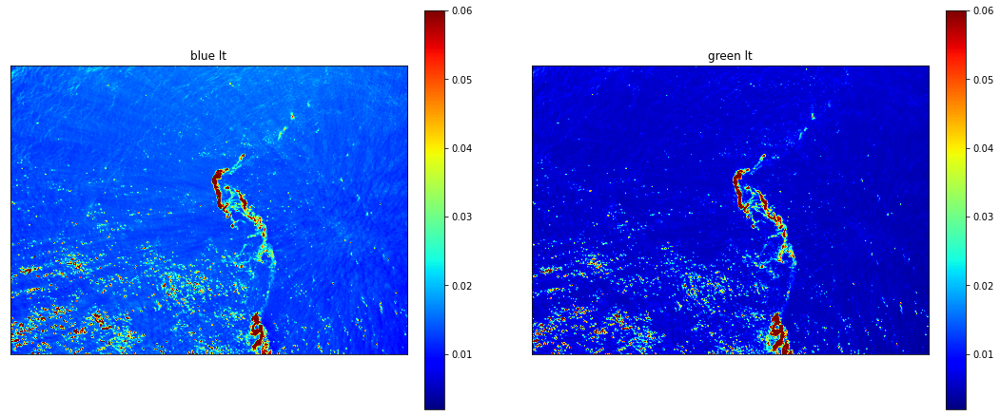

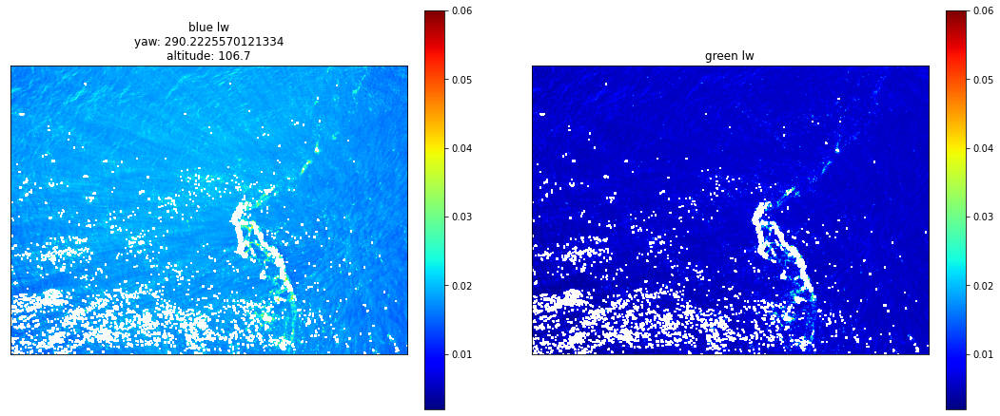

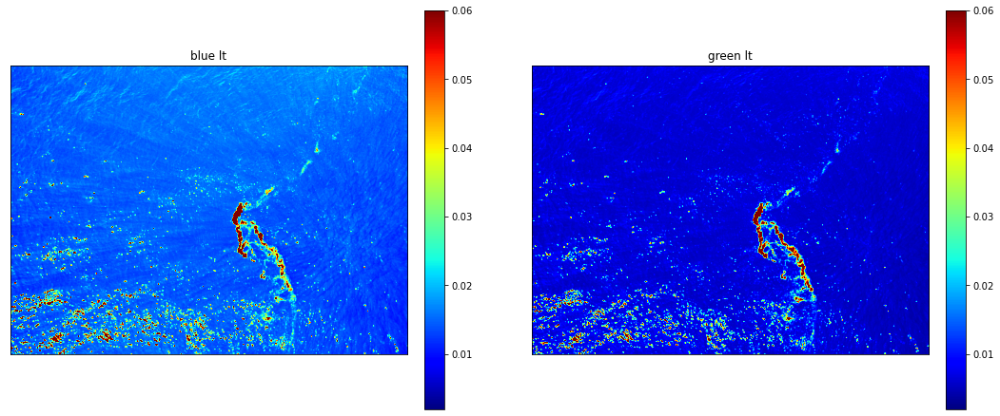

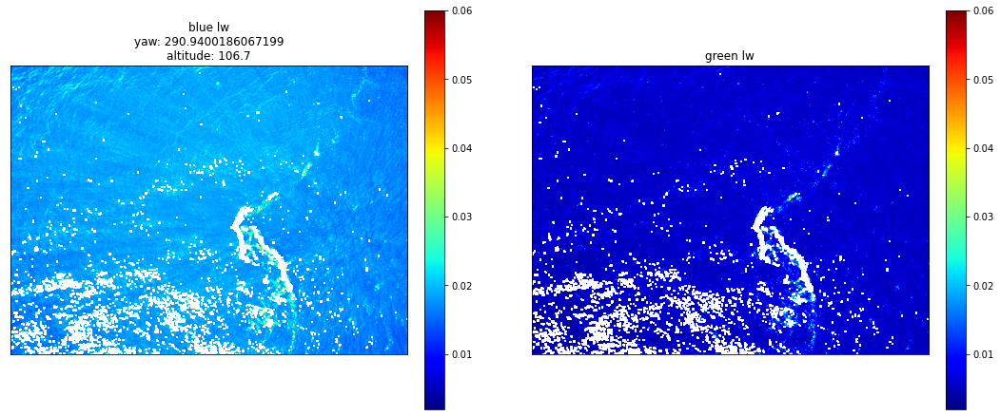

...

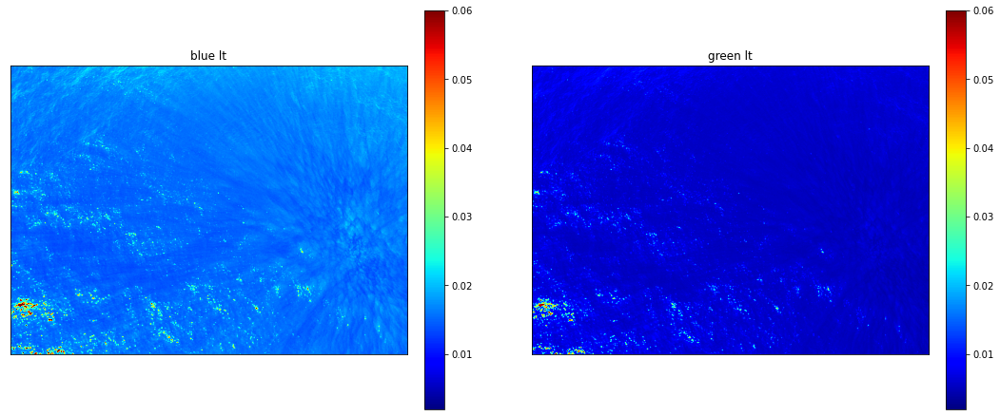

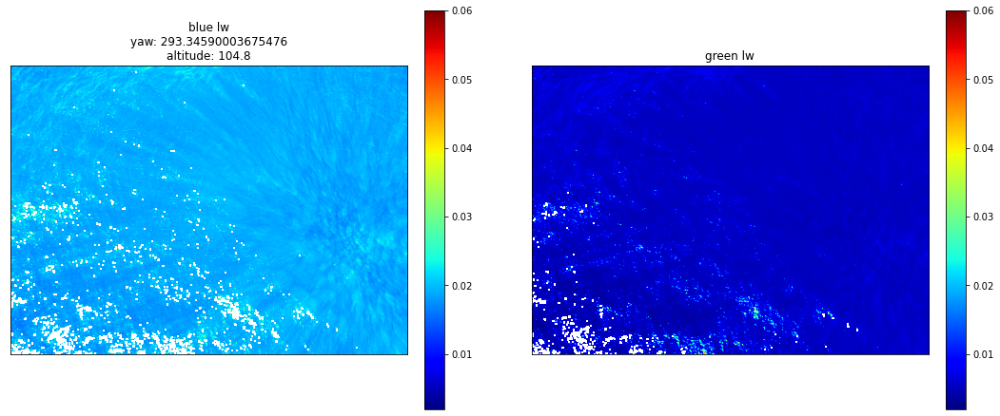

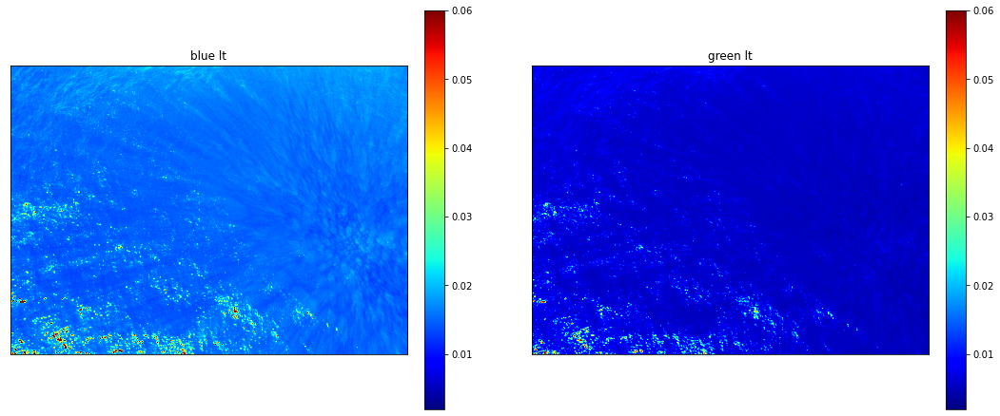

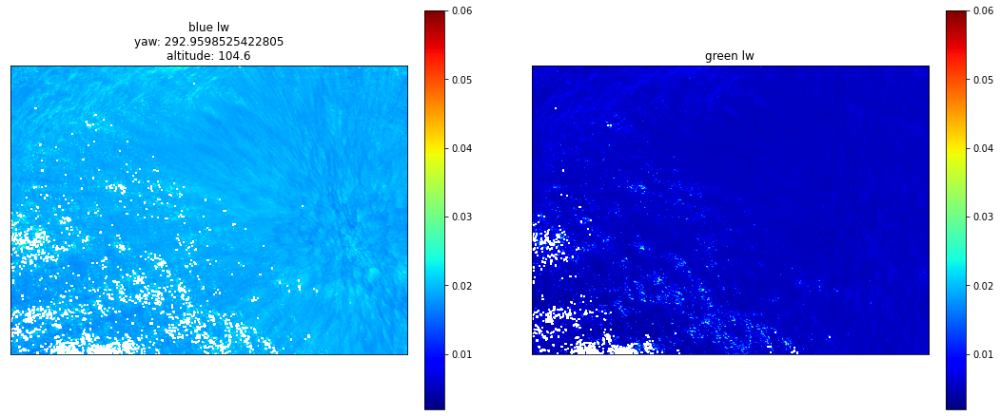

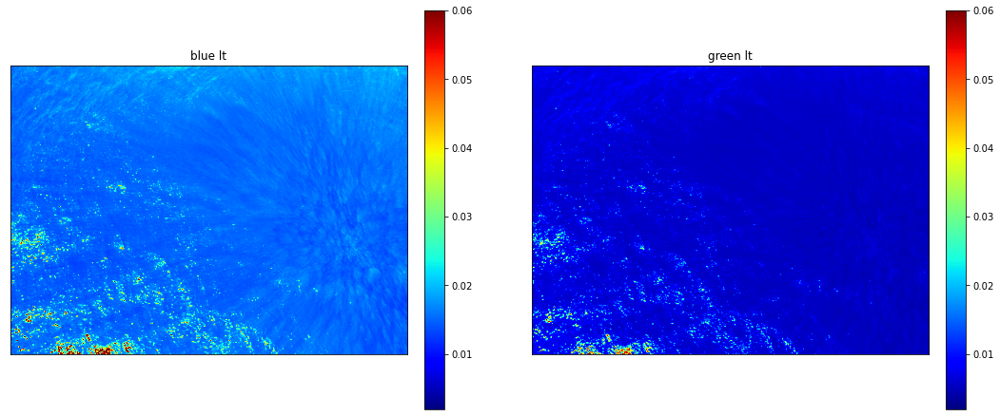

In [47]:
for i in range(0,25):
    fig, ax = plt.subplots(1,2, figsize=(18,8))
    img = sea_imgs[i,:5] - smoothed_lt_lw
    
    img[img > 0.055] = np.nan
    
    
    im = ax[0].imshow(img[0],cmap='jet', vmin=0.002, vmax=.06)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue lw\nyaw: ' + str(sea_img_metadata[i]['yaw']) + '\naltitude: ' + str(sea_img_metadata[i]['Altitude']))
    im = ax[1].imshow(img[1],cmap='jet', vmin=0.002, vmax=.06)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green lw')
    plt.show()
    
    fig, ax = plt.subplots(1,2, figsize=(18,8))
    
    im = ax[0].imshow(sea_imgs[i,0],cmap='jet', vmin=0.002, vmax=.06)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue lt')
    im = ax[1].imshow(sea_imgs[i, 1],cmap='jet', vmin=0.002, vmax=.06)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green lt')
    plt.show()

#### Inspect the spectra from this

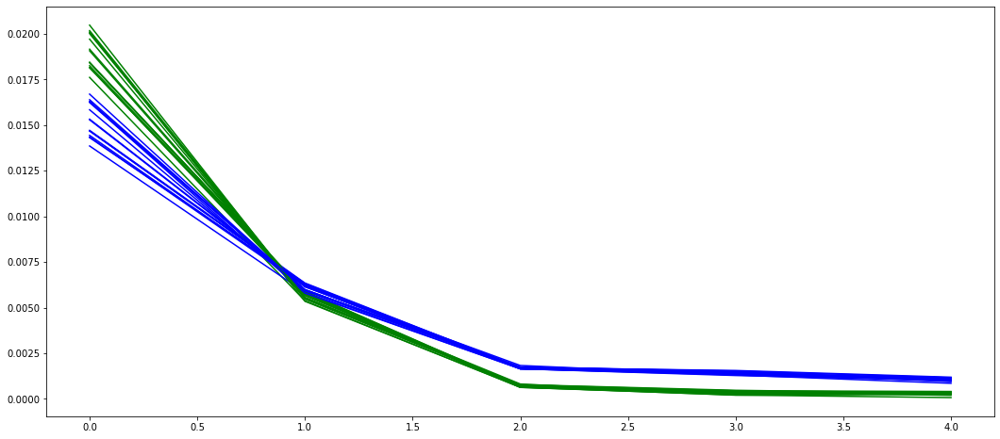

In [48]:
fig, ax = plt.subplots(figsize=(18,8))

for i in range(0,15):
    img = sea_imgs[i,:5] - smoothed_lt_lw
    
#    img[img > 0.055] = np.nan
    
    ax.plot(np.nanmedian(img,axis=(1,2)), color='green')
    ax.plot(np.nanmedian(sea_imgs[i,:5],axis=(1,2)), color='blue')

In [85]:
img = sea_imgs[5,:5].copy() - smoothed_lt_lw
img[np.repeat((img[2] > 0.085)[np.newaxis,:,:],5,axis=0)] = np.nan
    
chla_oci = oc_index(img[0], img[1], img[2])

# chla_oci = vec_chla_img(img[0], img[1])

In [86]:
np.nanmean(img, axis=(1,2))

array([0.01518858, 0.00735544, 0.00193284, 0.00219971, 0.00172218])

In [87]:
chla_oci[chla_oci > 10] = 10

In [88]:
np.nanmean(chla_oci)

0.38201179777419436

In [89]:
np.nanmedian(chla_oci)

0.22467031672539675

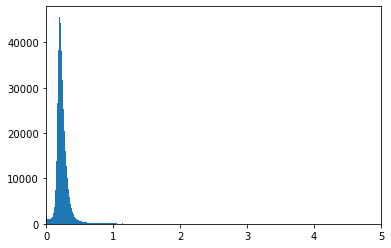

In [90]:
plt.hist(chla_oci.flatten(),  bins=5000)
plt.xlim(0,5)
plt.show()

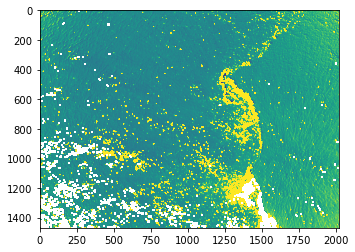

In [92]:
plt.imshow(chla_oci, vmin=np.nanmedian(chla_oci)-0.3, vmax=np.nanmedian(chla_oci)+0.3)

In [93]:
sea_imgs.shape

(45, 6, 1470, 2021)

In [127]:
(sea_median[:5,:,:].T - np.median(blocked_spectra, axis=0))[:,:,0].flatten()

(2021, 1470)

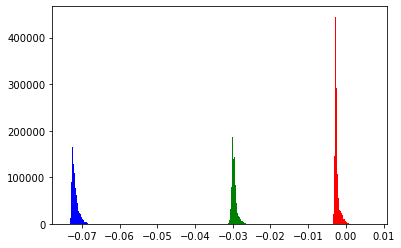

In [75]:
plt.hist((sea_median[:5,:,:].T - np.median(blocked_spectra, axis=0))[:,:,0].flatten(), bins=100, color='blue')
plt.hist((sea_median[:5,:,:].T - np.median(blocked_spectra, axis=0))[:,:,1].flatten(), bins=100, color='green')
plt.hist((sea_median[:5,:,:].T - np.median(blocked_spectra, axis=0))[:,:,2].flatten(), bins=100, color='red')
plt.show()

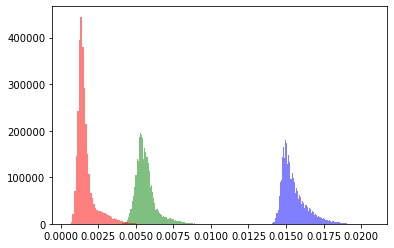

In [81]:
plt.hist((sea_median[:5,:,:]).T[:,:,0].flatten(), bins=100, color='blue',alpha=0.5)
plt.hist((sea_median[:5,:,:]).T[:,:,1].flatten(), bins=100, color='green',alpha=0.5)
plt.hist((sea_median[:5,:,:]).T[:,:,2].flatten(), bins=100, color='red',alpha=0.5)
plt.show()

oc index median is:
0.2118728405682122


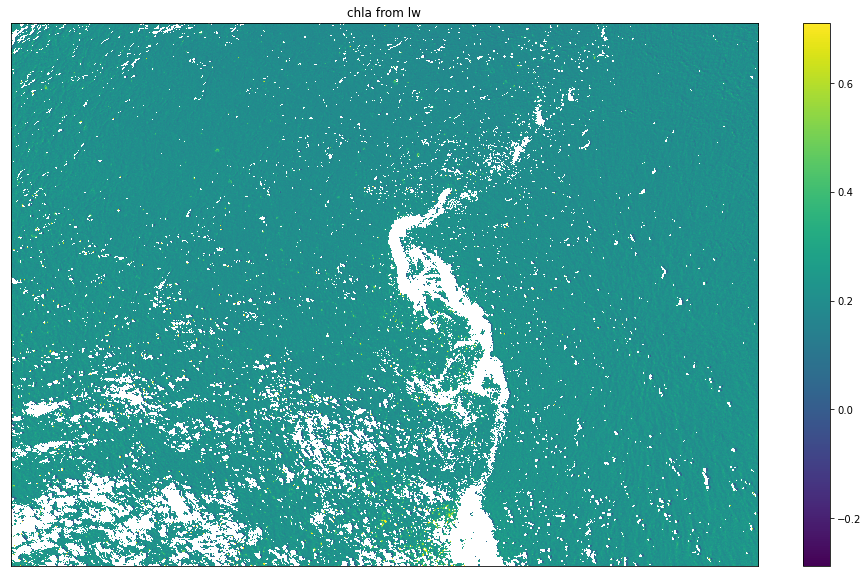

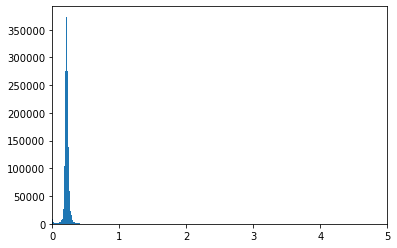

oc index median is:
0.21067159096887803


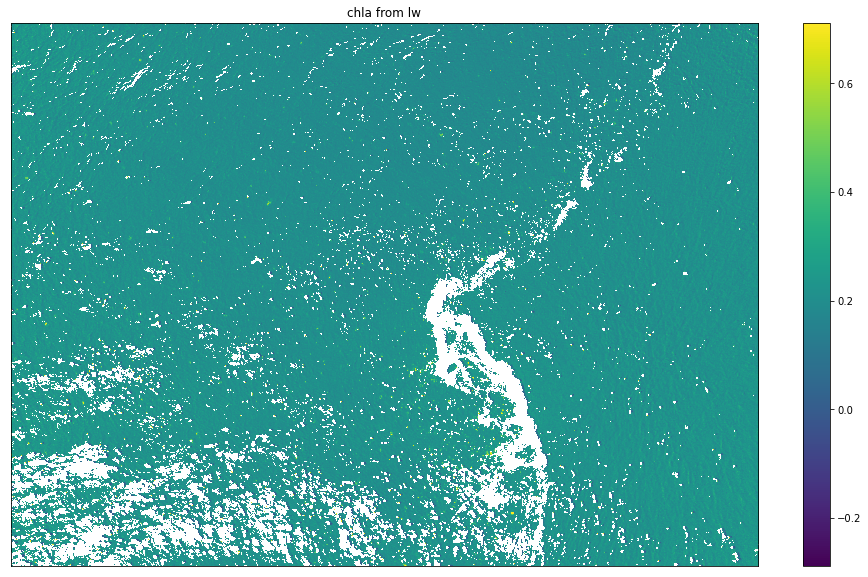

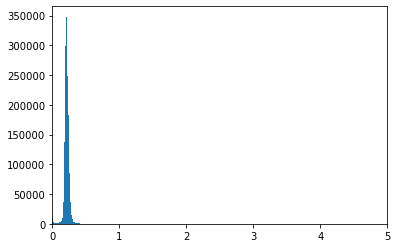

oc index median is:
0.21157666123763555


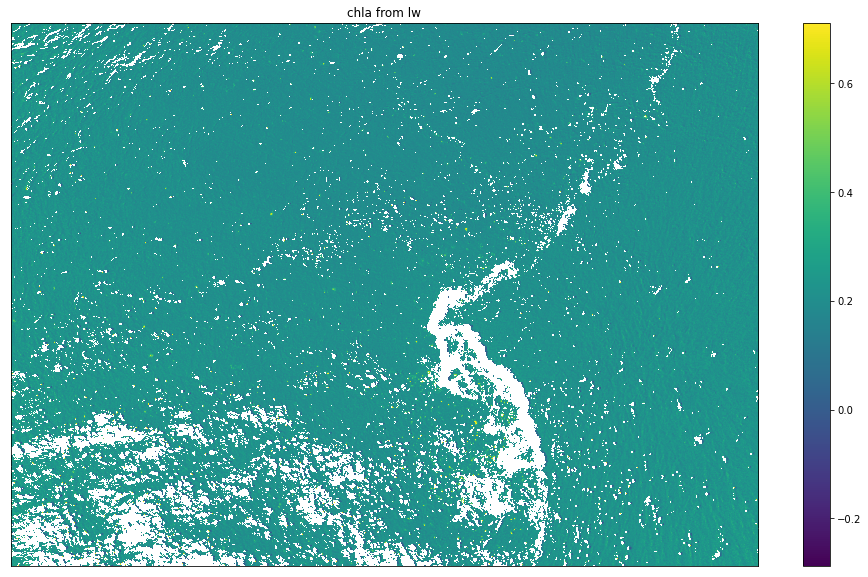

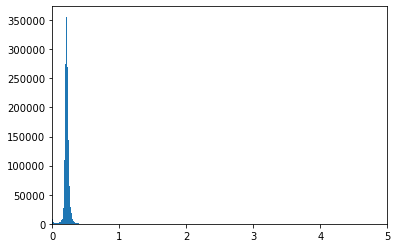

oc index median is:
0.21030115770694355


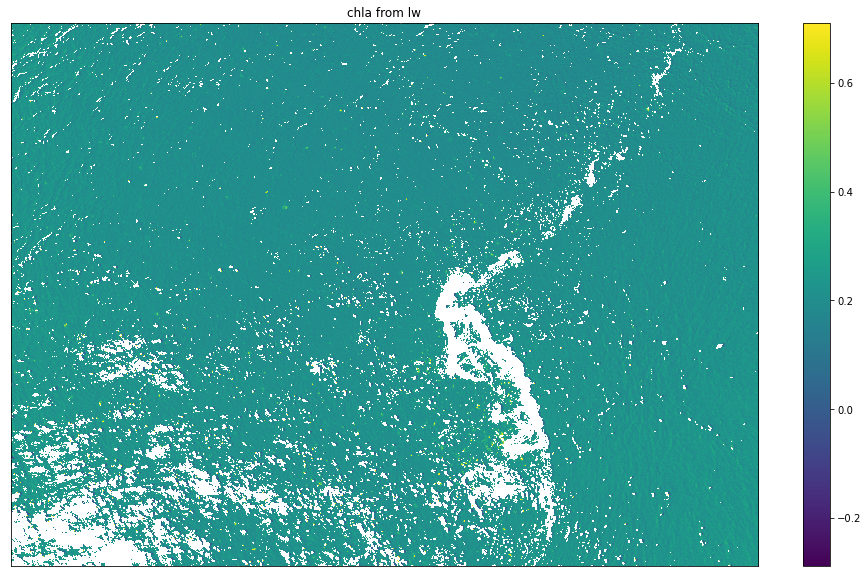

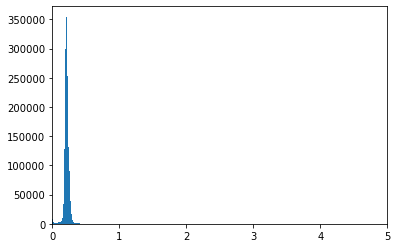

oc index median is:
0.21260071305186412


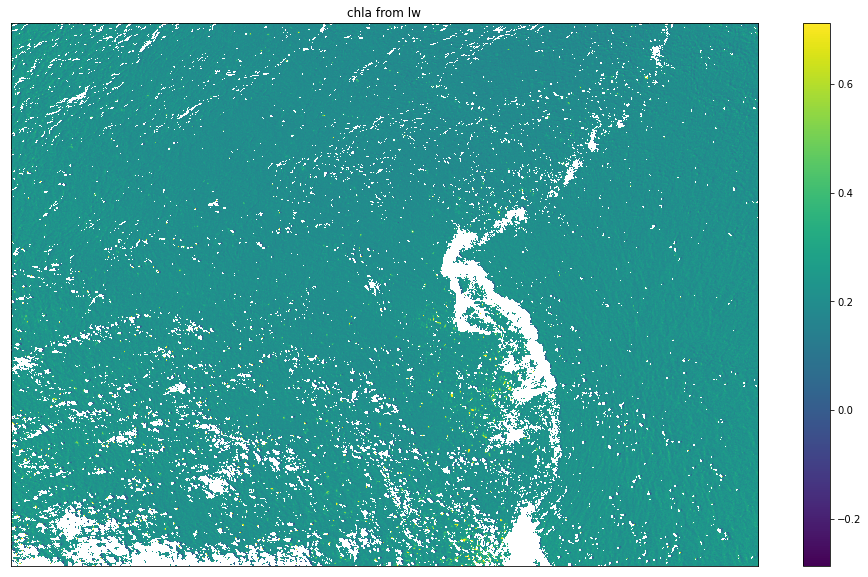

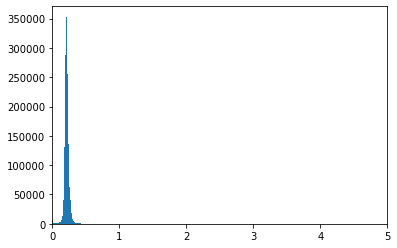

oc index median is:
0.2123897563465988


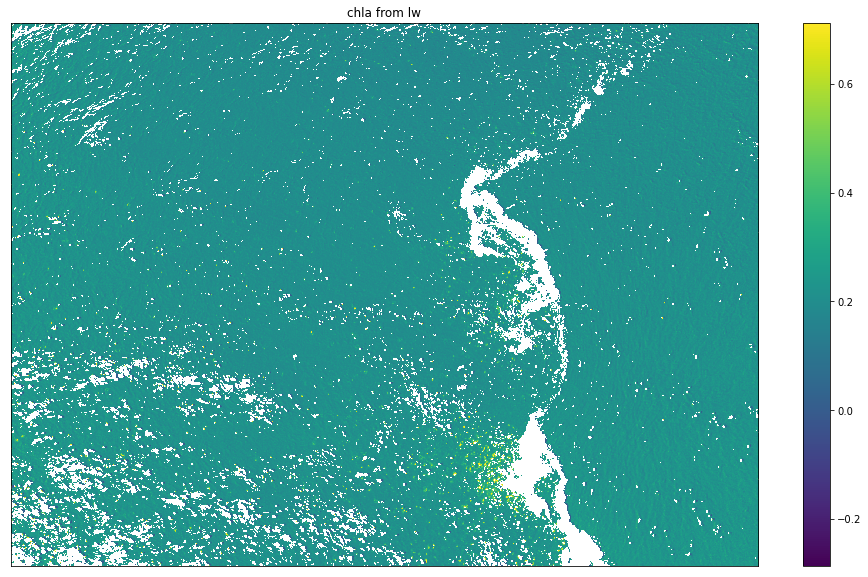

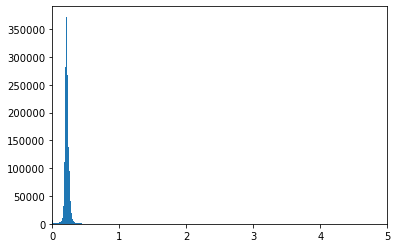

oc index median is:
0.21546922176359357


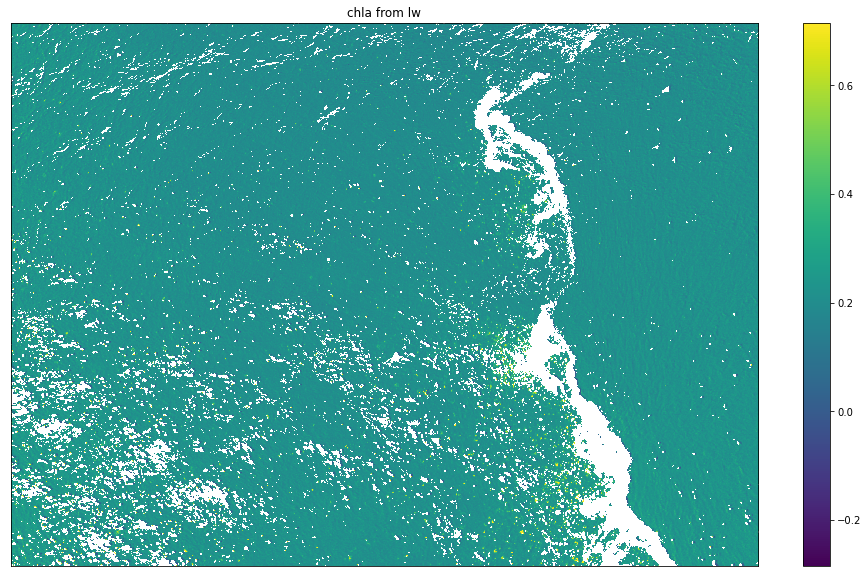

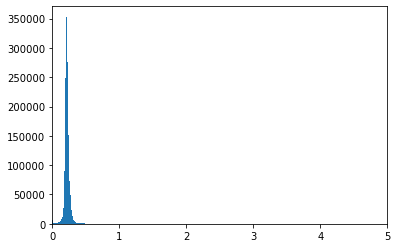

oc index median is:
0.1962360273165187


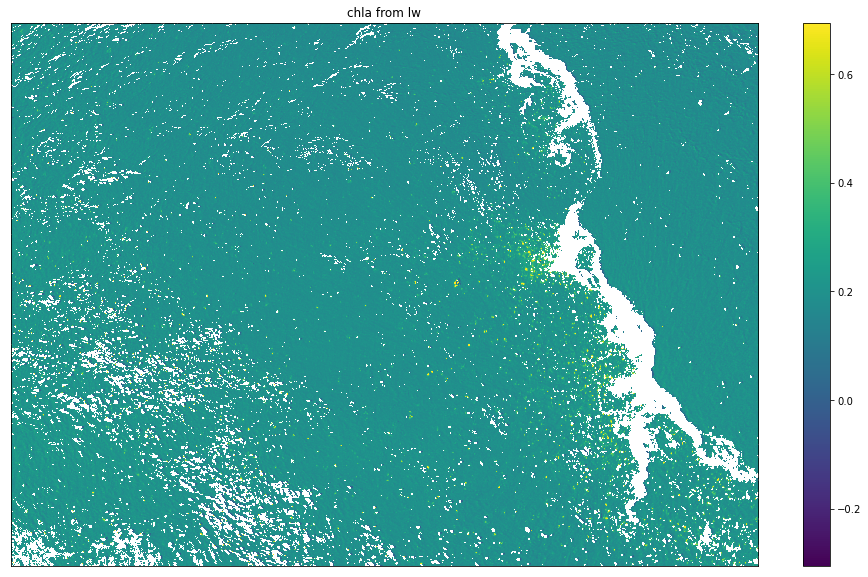

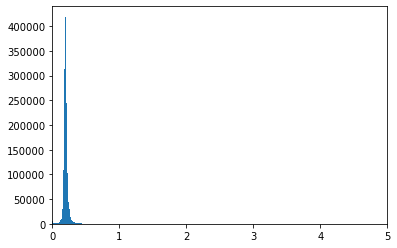

oc index median is:
0.1934925512763599


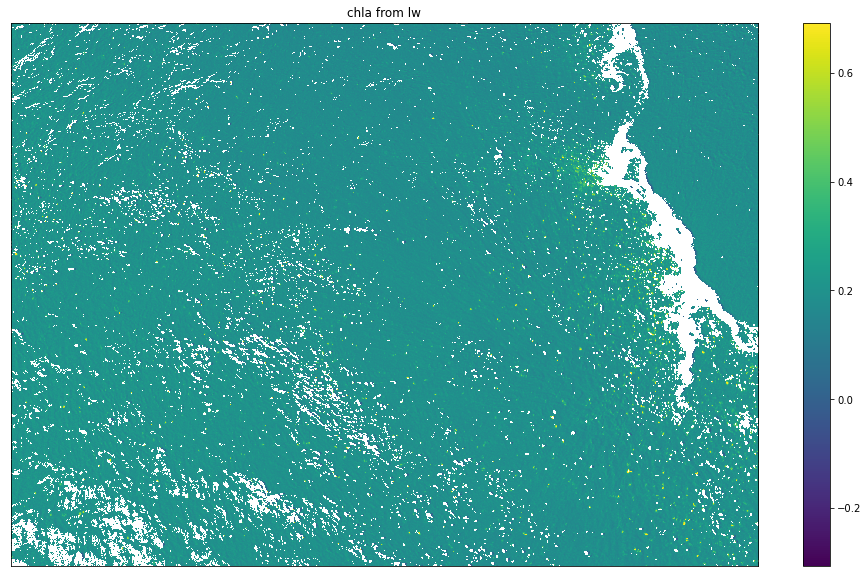

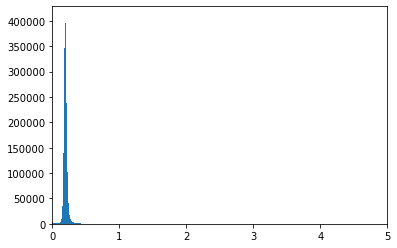

oc index median is:
0.18114734167355176


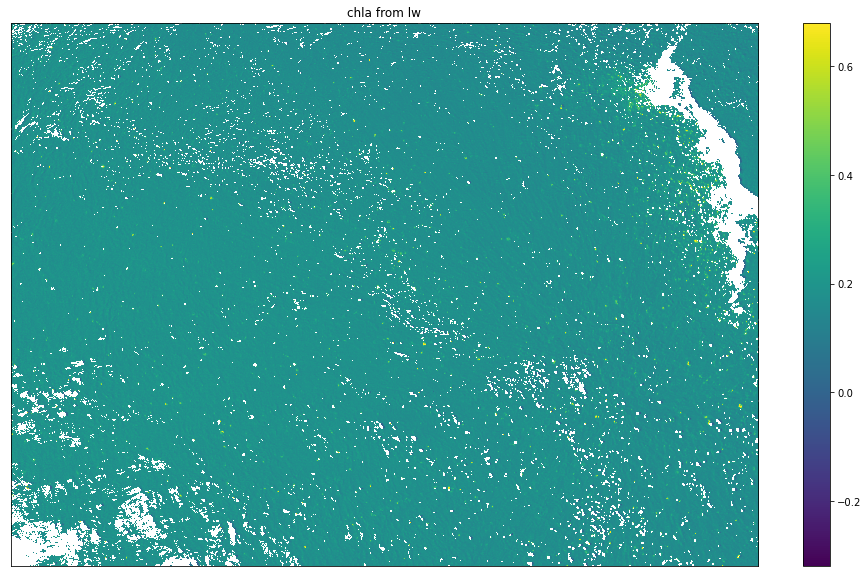

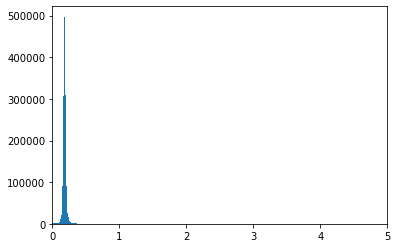

oc index median is:
0.17322501722213474


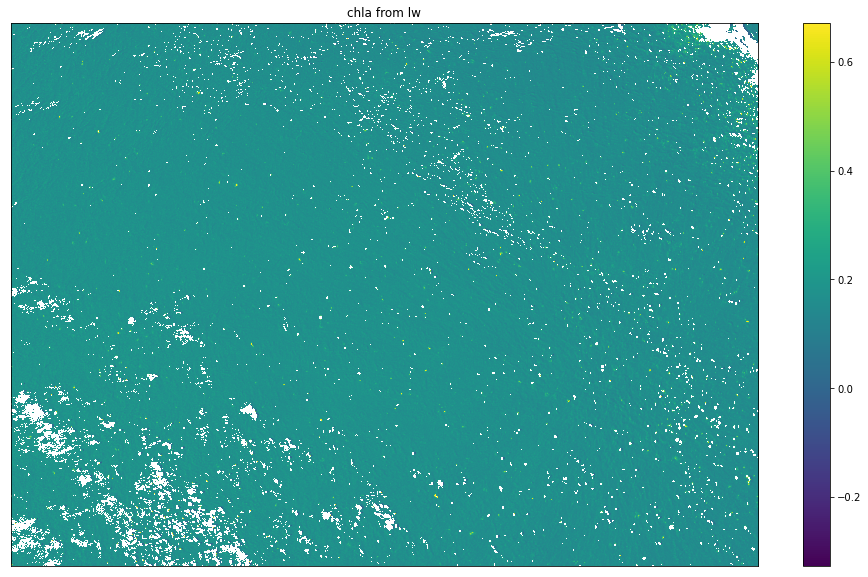

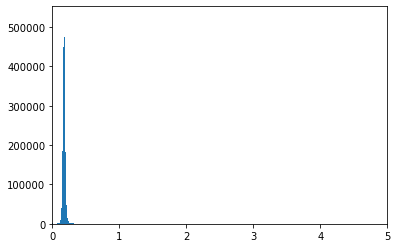

oc index median is:
0.16907018722882586


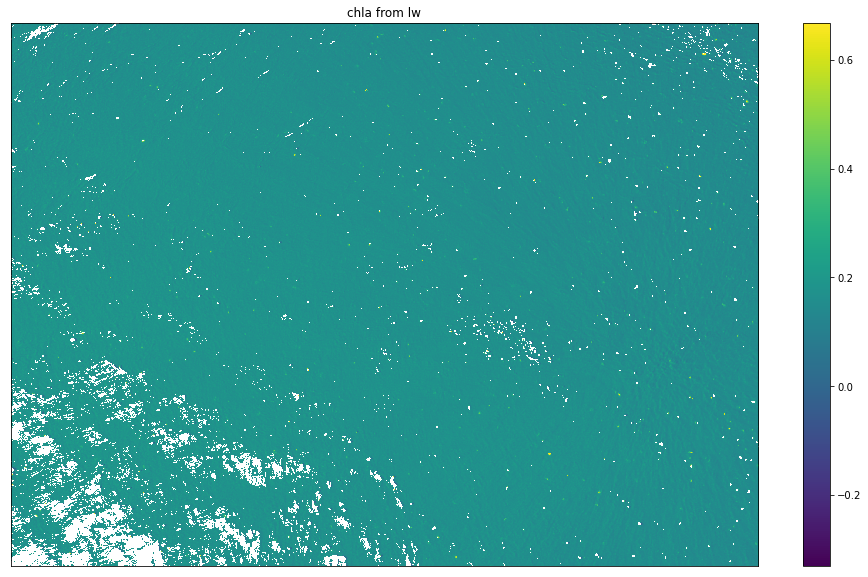

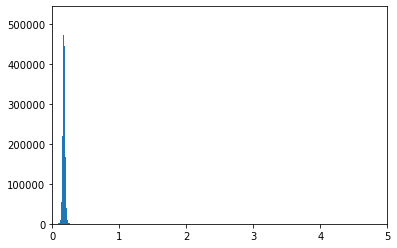

oc index median is:
0.1768024934497625


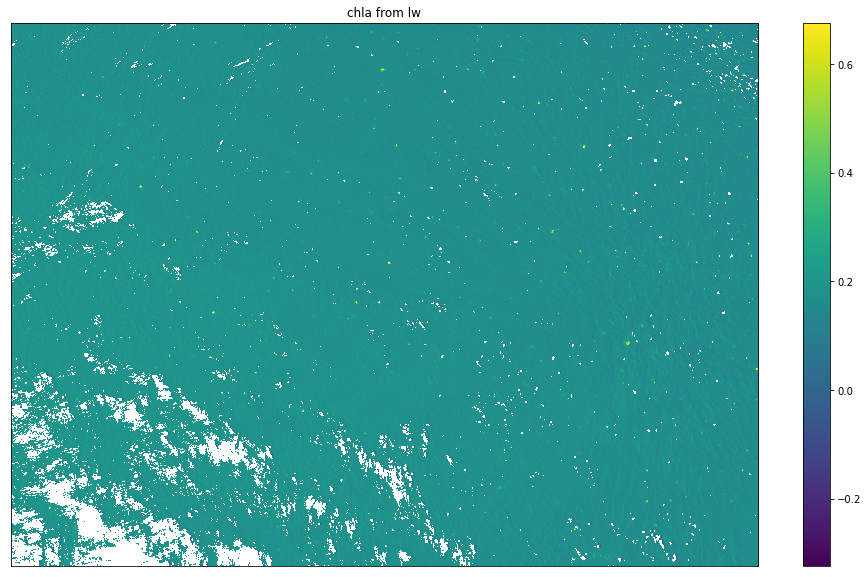

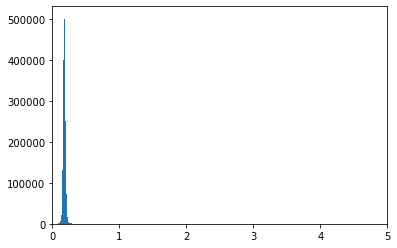

oc index median is:
0.17515867656022083


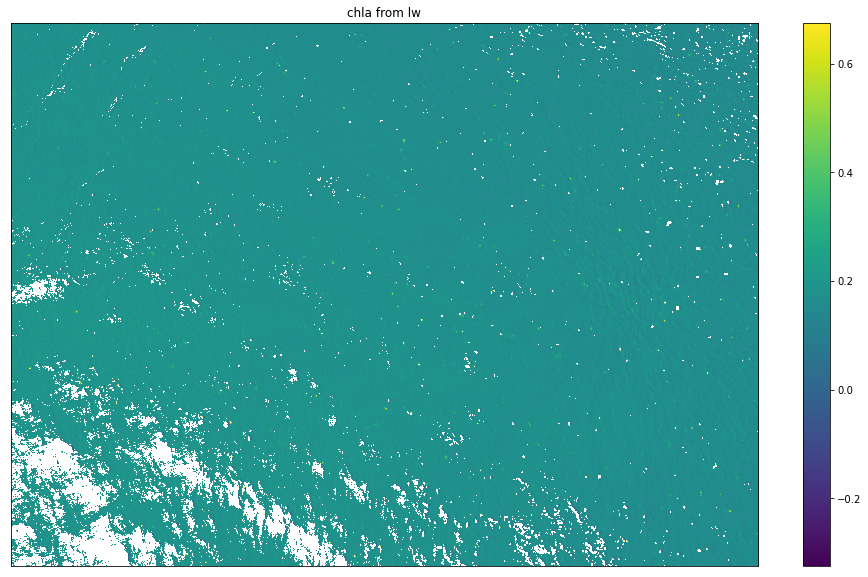

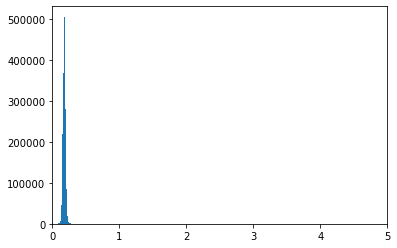

oc index median is:
0.17502435816324804


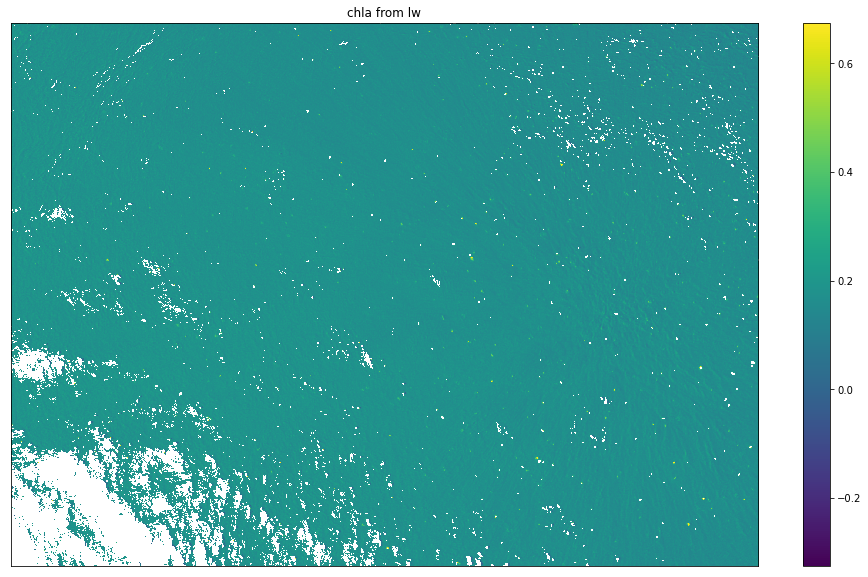

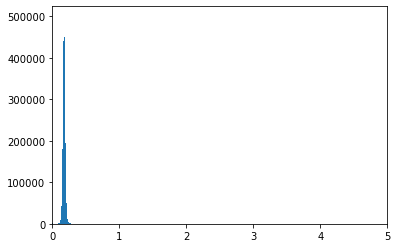

oc index median is:
0.17502435816324816


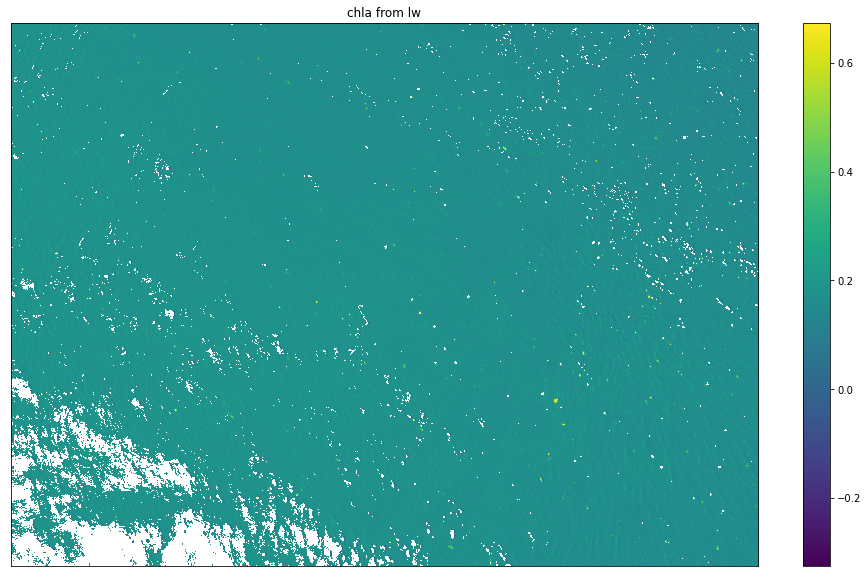

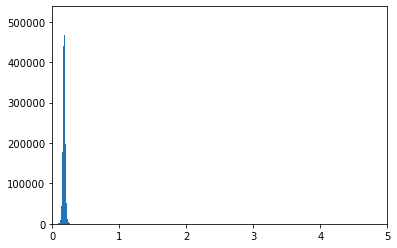

oc index median is:
0.17444874896335696


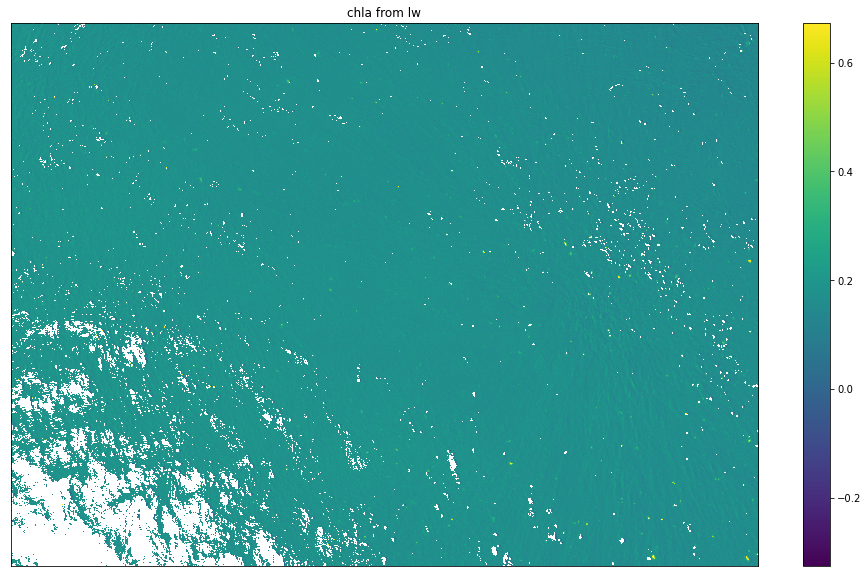

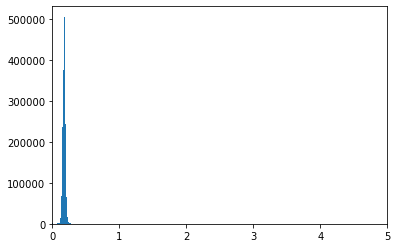

oc index median is:
0.17322501722213476


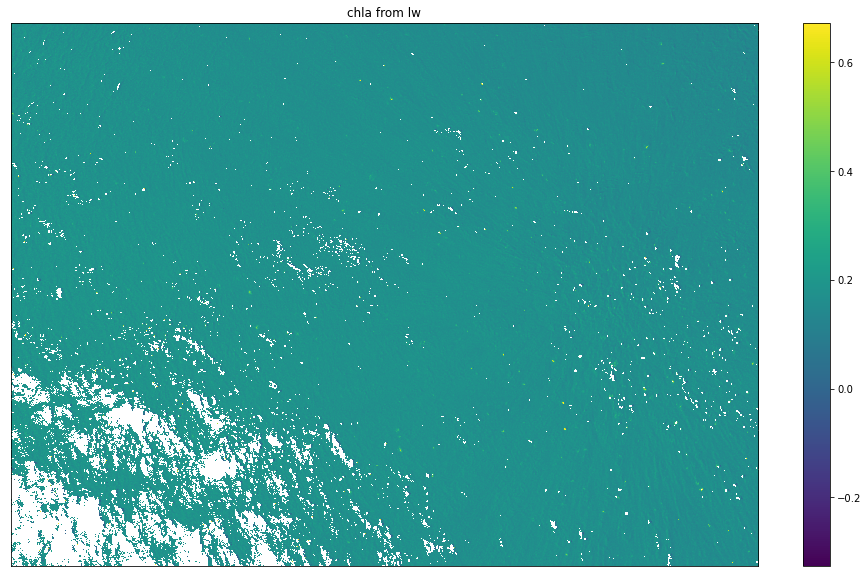

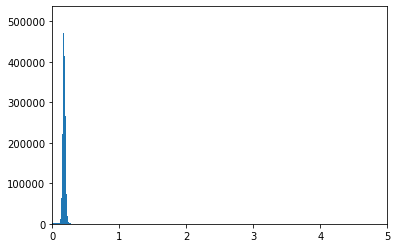

oc index median is:
0.17498487235808366


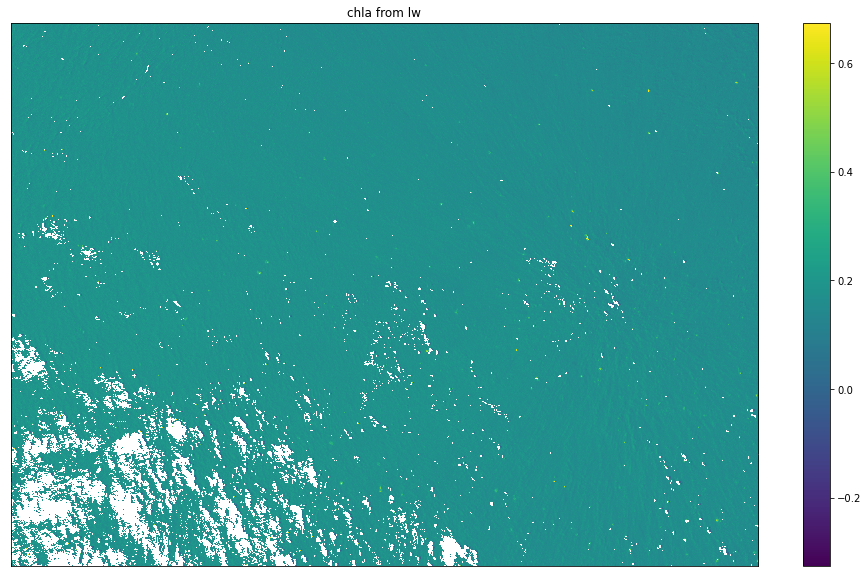

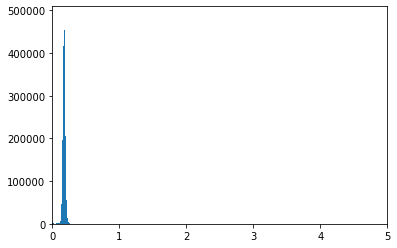

oc index median is:
0.17569698173495735


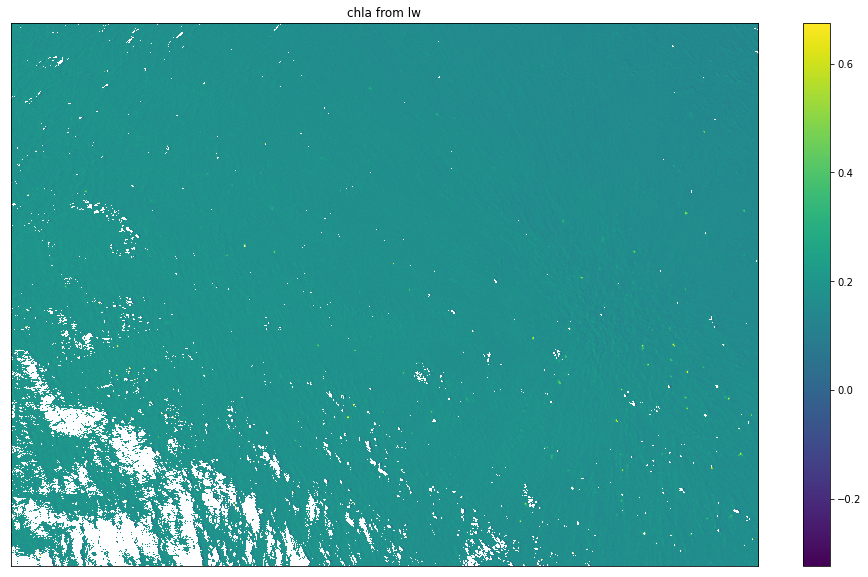

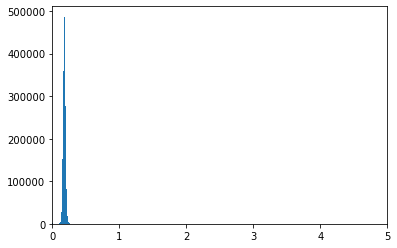

oc index median is:
0.17672272853706214


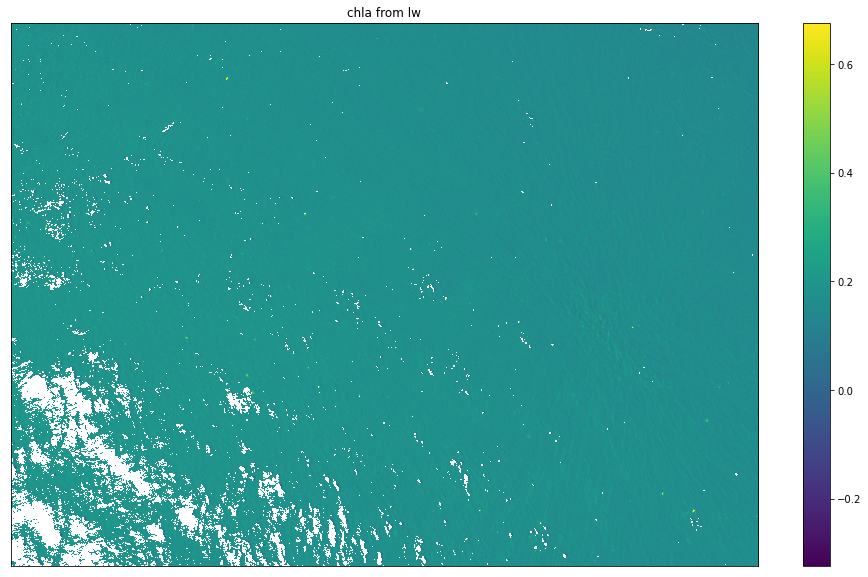

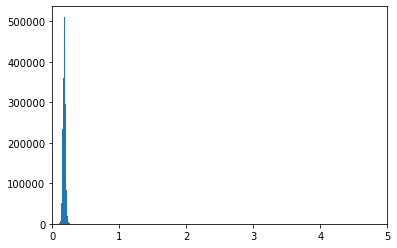

oc index median is:
0.17607001218183246


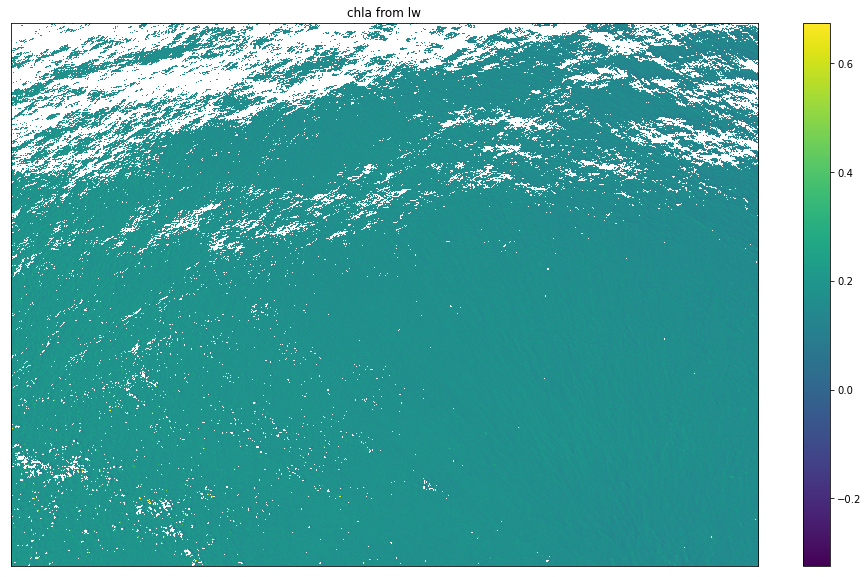

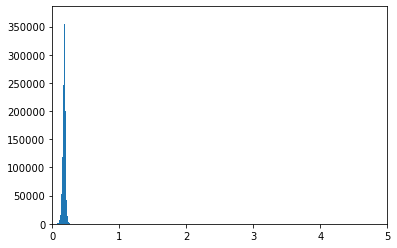

oc index median is:
0.18371577848593343


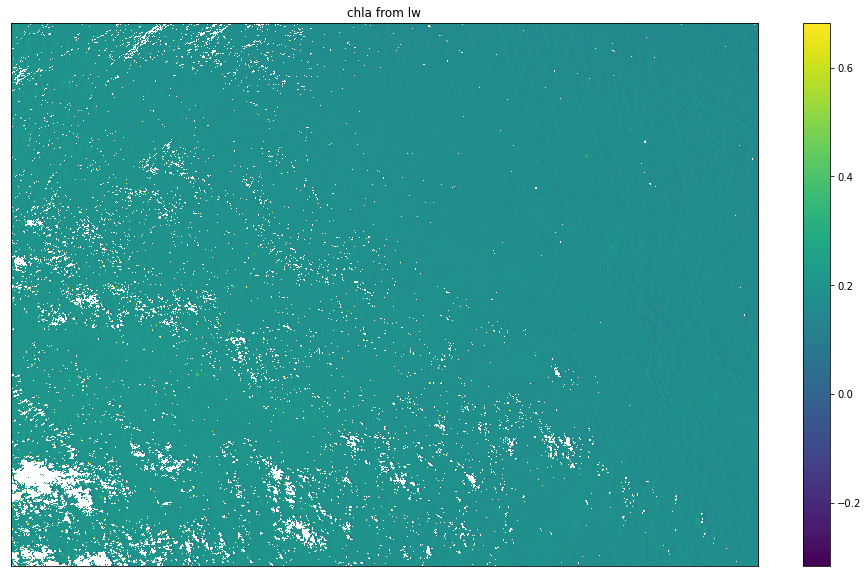

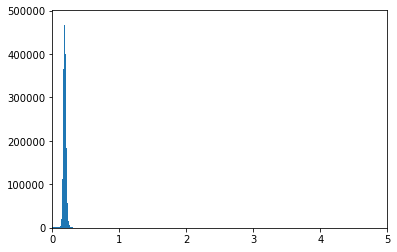

oc index median is:
0.19047774475723978


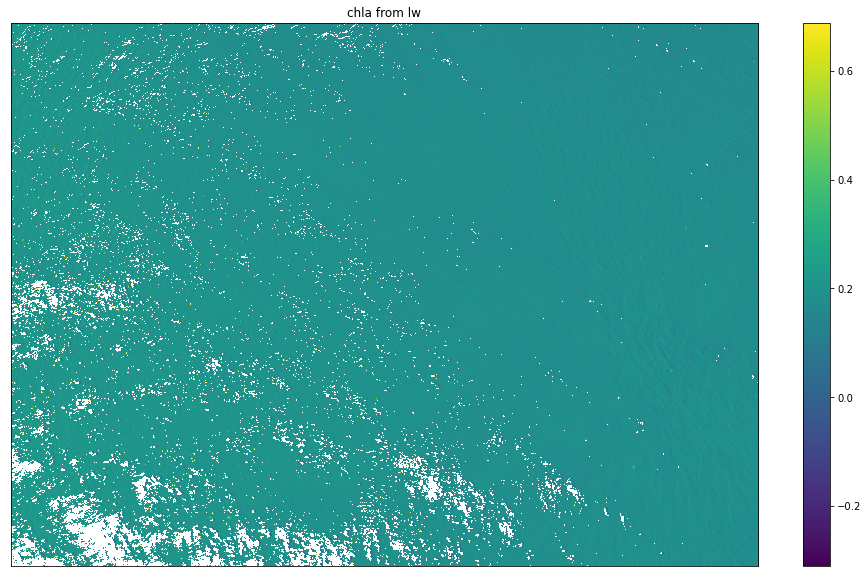

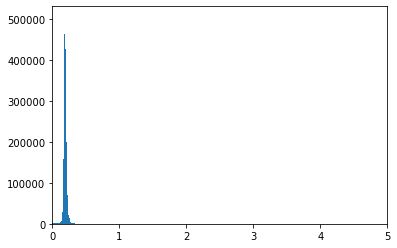

oc index median is:
0.18966293019956923


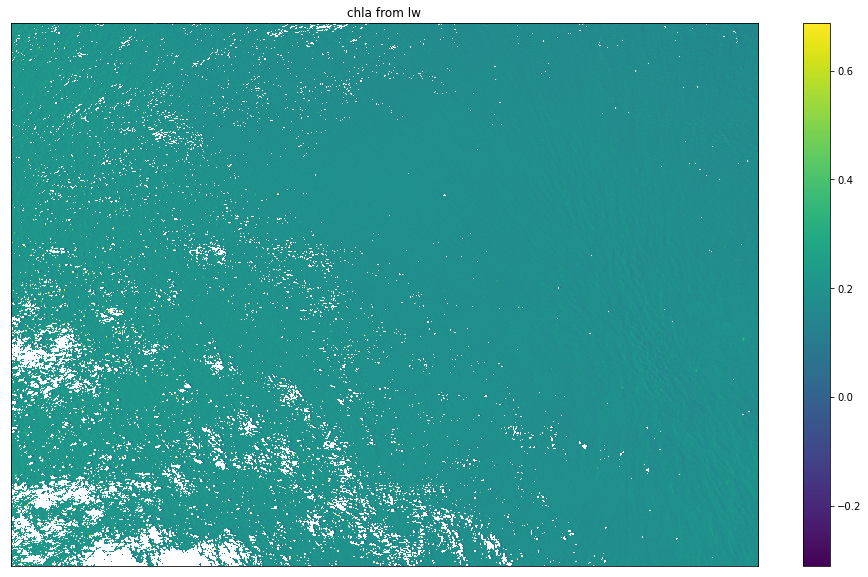

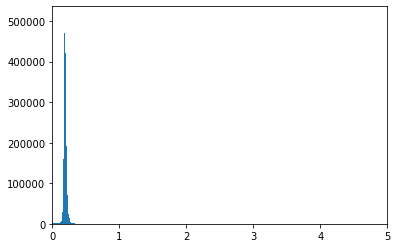

oc index median is:
0.1909596954546516


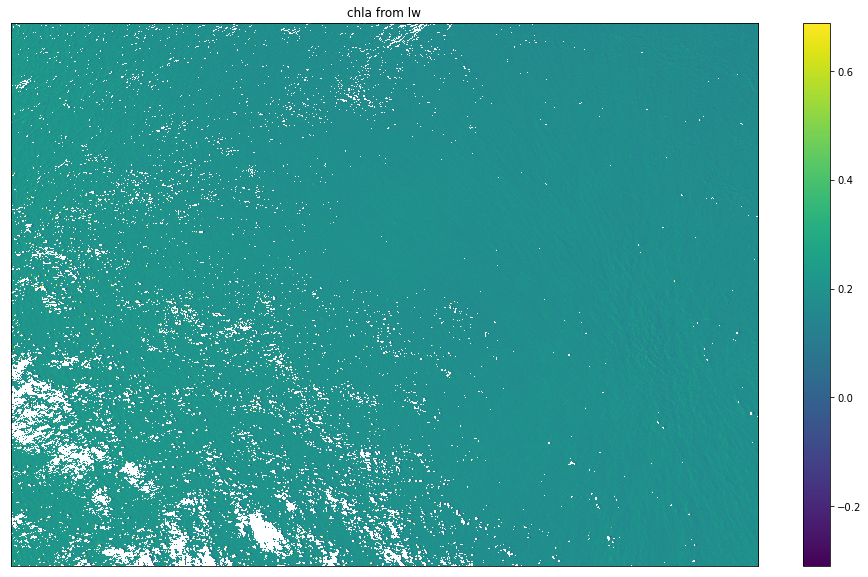

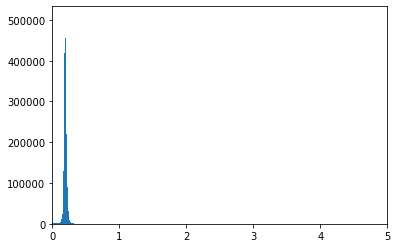

oc index median is:
0.1909596954546516


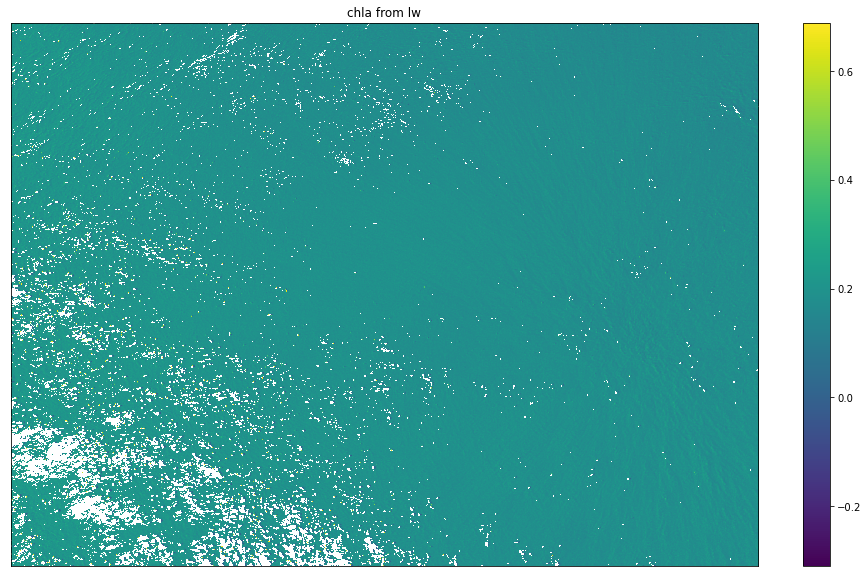

KeyboardInterrupt: 

In [82]:
for i in range(0,30):
    fig, ax = plt.subplots(1, figsize=(20,10))
    img = sea_imgs[i,:5].copy()# - smoothed_lt_lw
    img[np.repeat((img[2] > 0.004)[np.newaxis,:,:],5,axis=0)] = np.nan
        
    #chla_lw = vec_chla_img(img[0], img[1])
    #chla_lw = chla_lw[:500,:-1600]
    #img = img[:,:500,:-1600]    
    
    chla_oci = oc_index(img[0], img[1], img[2])
#     chla_oci = vec_chla_img(img[0], img[1])
    chla_oci[chla_oci<0] = 0
    chla_oci[chla_oci>4] = np.nan
    
    img_median = np.nanmedian(img, axis=(1,2))
    print('oc index median is:')
    print(oc_index(img_median[0], img_median[1], img_median[2]))
    
    #print(vec_chla_img(img_median[0], img_median[1]))
    #print(np.nanmedian(chla_lw))
    im = ax.imshow(chla_oci,cmap='viridis', vmin=np.nanmedian(chla_oci)-.5, vmax=np.nanmedian(chla_oci)+.5, interpolation='none')
    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title('chla from lw')
    plt.show()
    
    plt.hist(chla_oci.flatten(), bins=500)
    plt.xlim(0,5)
    plt.show()


What does this look like slightly blurred?

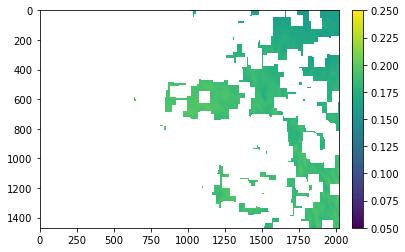

In [83]:
fig,ax = plt.subplots()
im = ax.imshow(ndimage.gaussian_filter(chla_oci, sigma=(9, 9), order=0), cmap='viridis', vmin=0.05, vmax=0.25, interpolation='none')
fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

Fill gaps just to see whole image

In [84]:
# TODO this is not the *ideal* solution
# make a mask where there are nans
mask = np.isnan(chla_oci)
# get the indices where the mask is not existant
idx = np.where(~mask,np.arange(mask.shape[1]),0)
np.maximum.accumulate(idx,axis=1, out=idx)
out = chla_oci[np.arange(idx.shape[0])[:,None], idx]

In [139]:
from scipy import interpolate
#mask invalid values
x = np.arange(0, chla_oci.shape[1])
y = np.arange(0, chla_oci.shape[0])
array = np.ma.masked_invalid(chla_oci)
xx, yy = np.meshgrid(x, y)
#get only the valid values
x1 = xx[~array.mask]
y1 = yy[~array.mask]
newarr = array[~array.mask]

GD1 = interpolate.griddata((x1, y1), newarr.ravel(),
                          (xx, yy),
                             method='nearest')

In [110]:
GD1.shape

(1470, 2021)

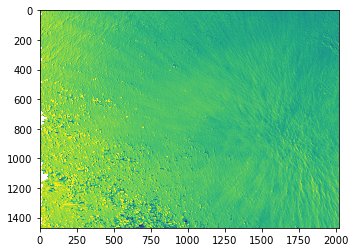

In [85]:
plt.imshow(out,cmap='viridis', vmin=0.05, vmax=0.25)

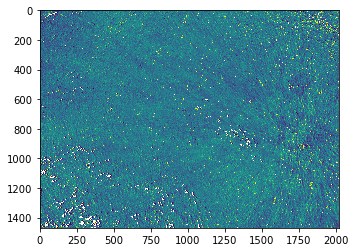

In [147]:
plt.imshow(chla_oci,cmap='viridis', vmin=0.05, vmax=0.25, interpolation='none')

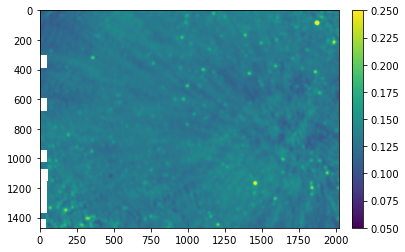

In [148]:
fig,ax = plt.subplots()
im = ax.imshow(ndimage.gaussian_filter(out, sigma=(9, 9), order=0), cmap='viridis', vmin=0.05, vmax=0.25)
fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

##### Inspect the data geographically

Turn each image to a point and put it into a gdf

In [85]:
img = retrieve_imgs_and_metadata(surface_dir, count=1, start=95, altitude_cutoff=0)[0]
sst = img[0,5]

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


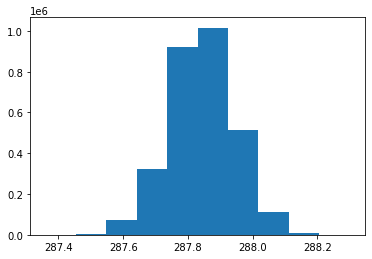

In [86]:
plt.hist((sst* 32768 / 100).flatten())
plt.show()

(0.0, 4.0)

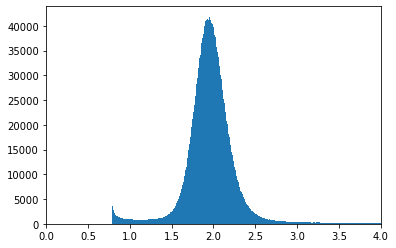

In [137]:
plt.hist(lw_img[1].flatten(), bins=1000)
plt.xlim(0,0.1)

In [149]:
%matplotlib inline

In [ ]:
10,-31

In [ ]:
img = sea_imgs[i,:5].copy() - smoothed_lt_lw

In [ ]:
sea_imgs[i,:5]

In [ ]:
    fig, ax = plt.subplots(1, figsize=(20,10))
    img = sea_imgs[i,:5].copy()# - smoothed_lt_lw
    img[np.repeat((img[2] > 0.004)[np.newaxis,:,:],5,axis=0)] = np.nan
        
    #chla_lw = vec_chla_img(img[0], img[1])
    #chla_lw = chla_lw[:500,:-1600]
    #img = img[:,:500,:-1600]    
    
    chla_oci = oc_index(img[0], img[1], img[2])
#     chla_oci = vec_chla_img(img[0], img[1])
    chla_oci[chla_oci<0] = 0
    chla_oci[chla_oci>4] = np.nan

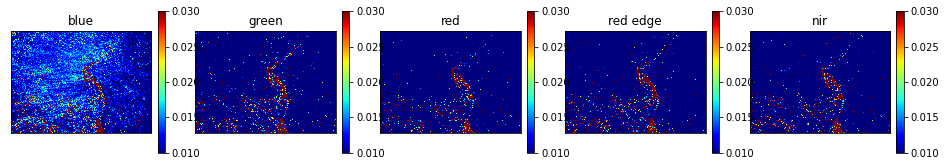

In [157]:
visualize_darkest_pixels(sea_imgs[0,:5]- smoothed_lt_lw, lowest_percent=1, max_clim=0.03, min_clim=0.01, only_img=True)

(1, 6, 1470, 2021)


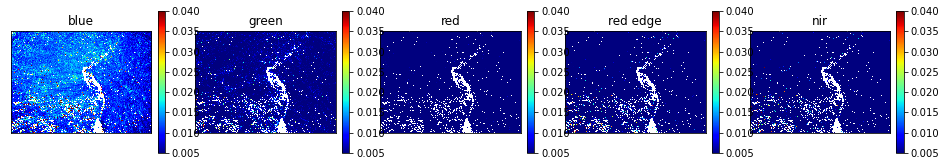

0.22329788791079153


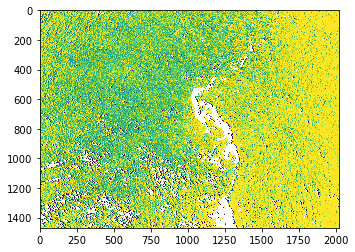

In [160]:
count = 0
for i in range(10,len(mds)-10-31):
    count +=1
    if count ==10:
        print('10th image')
        count = 0
    img = retrieve_imgs_and_metadata(surface_dir, count=1, start=i, altitude_cutoff=0)[0]
    print(img.shape)
    lw_img = img[0,:5,:,:] - smoothed_lt_lw
    lw_img[np.repeat((lw_img[2] > 0.004)[np.newaxis,:,:],5,axis=0)] = np.nan
    
    visualize_darkest_pixels(lw_img, lowest_percent=1, max_clim=0.04, min_clim=0.005, only_img=True)
    
    
    chla_img = oc_index(lw_img[0], lw_img[1], lw_img[2])
    chla_img[chla_img<0] = 0
    chla_img[chla_img>4] = np.nan
    plt.imshow(chla_img, vmin=0.05,vmax=0.25, interpolation='none')
    print(np.nanmedian(chla_img))
    break

In [86]:
lats = []
lons = []
chla_list = []
chla_dates = []
temps = []
count = 0
for i in range(10,len(mds)-10-31):
    count +=1
    if count ==10:
        #print('10th image')
        count = 0
    img = retrieve_imgs_and_metadata(surface_dir, count=1, start=i, altitude_cutoff=0)[0]
    
    sst = img[0,5]
    sst_in_k = np.median(sst) * 32768 / 100
#     plt.imshow(sst* 32768 / 100, vmin=288,vmax=292)
#     print(sst_in_k)
#     plt.show()
    
    img = img[0,:5,:,:]# - smoothed_lt_lw
    #img = sea_imgs[i,:5].copy() 
    img[np.repeat((img[2] > 0.004)[np.newaxis,:,:],5,axis=0)] = np.nan
    chla_img = oc_index(img[0], img[1], img[2])
    chla_img[chla_img<0] = 0
    chla_img[chla_img>6] = np.nan
    chla_med = np.nanmedian(chla_img)
    #img_median = np.nanmedian(img, axis=(1,2))
    #oc_med = oc_index(img_median[0], img_median[1], img_median[2])
    #oc_med = vec_chla_img(img_median[0], img_median[1])

    chla_list.append(chla_med)
    print(chla_med)
    lats.append(mds[i]['Latitude'])
    lons.append(mds[i]['Longitude'])
    chla_dates.append(datetime.datetime.strptime(mds[i]['Date']+' - '+mds[i]['UTC-Time'], '%m/%d/%Y - %H:%M:%S'))
    temps.append(sst_in_k)

0.2114048761777725
0.2110522003369543
0.21166260610690743
0.2108427801699993
0.21239934074502576
0.21253356774543397
0.21478967548789474
0.1943939825962668
0.19244761054683338
0.18021785810160332
0.1720564482114616
0.16856739807777957
0.17598263625611552
0.17507965325985927
0.1742520579974934
0.17408700897961107
0.17360846693748133
0.17320156824164787
0.1741970242788273
0.1754988833866338
0.17603029047526952
0.17478757691308822
0.18286386344989933
0.18877491866835033
0.18843448392098314
0.1893123510245817
0.18935506986368503
0.18701978844606607
0.18718020487629777
0.18712108808391434
0.18701134928537988
0.16978887093669467
0.16955152124147874
0.16991150397489002
0.1702415193339549
0.17187796600400126
0.17159123086678701
0.17209527320987328
0.17348316562910068
0.17404773464208248
0.17412629217949918
0.17535639089236663
0.17653940577859775
0.17761013994778688
0.17678653758755086
0.17663502869647144
0.17464566194861303
0.18803525750603223
0.18833247326480973
0.18750145064689655
0.18852804

In [87]:
len(chla_list)

356

<AxesSubplot:>

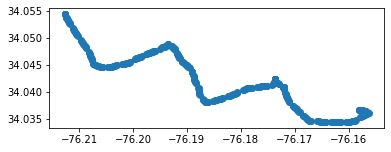

In [88]:
import geopandas as gpd
chla_df = pd.DataFrame(
    {'chla': chla_list,
     'Latitude': lats,
     'Longitude': lons,
     'time' : chla_dates,
     'sst' : temps
    })

chla_gdf = gpd.GeoDataFrame(
    chla_df, geometry=gpd.points_from_xy(chla_df.Longitude, chla_df.Latitude))
chla_gdf.plot()

<AxesSubplot:>

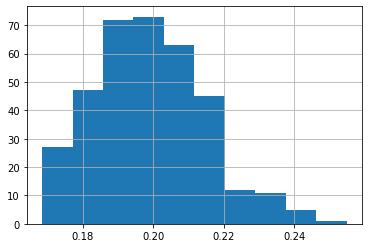

In [89]:
chla_gdf['chla'].hist()

<AxesSubplot:>

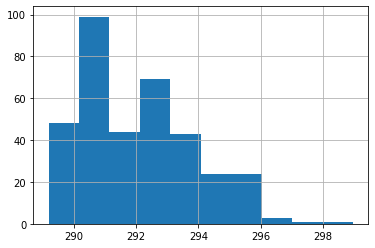

In [90]:
chla_gdf['sst'].hist()

<AxesSubplot:>

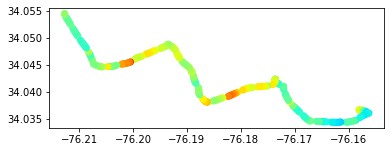

In [91]:
chla_gdf.plot(column=chla_gdf['chla'],vmin=0.12, vmax=0.27, cmap='jet')

<AxesSubplot:>

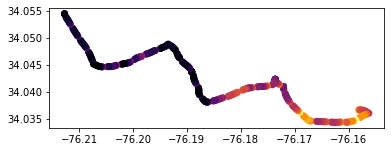

In [92]:
chla_gdf.plot(column=chla_gdf['sst'],vmin=290, vmax=297, cmap='inferno')

In [94]:
chla_gdf['time_str'] = chla_gdf['time'].astype(str)

In [95]:
chla_gdf.drop('time', 1).to_file('chla_sst_flight3_dls.shp')

### Write out the data as .tifs

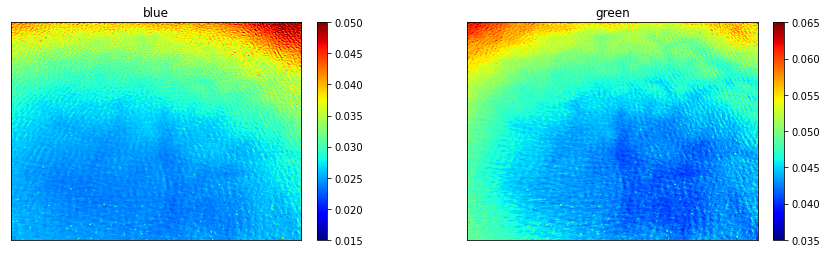

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[ 258.3914646  2348.50889259]
 [ 686.43797456  805.02304135]
 [1762.20844904 1473.83633639]
 [1525.06358628 2328.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 4000, 'height': 4000, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.6767996560071,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7147809111126), 'tiled': False, 'interleave': 'band'}
written out as  blue_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[ 258.3914646  2348.50889259]
 [ 686.43797456  805.02304135]
 [1762.20844904 1473.83633639]
 [1525.06358628 2328.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 4000, 'height': 4000, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.6767996560071,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7147809111126), 'tiled': False, 'interleave': 'band'}
written out as  green_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


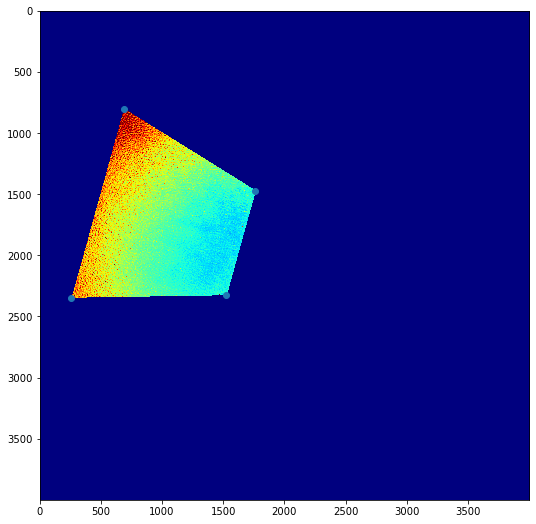

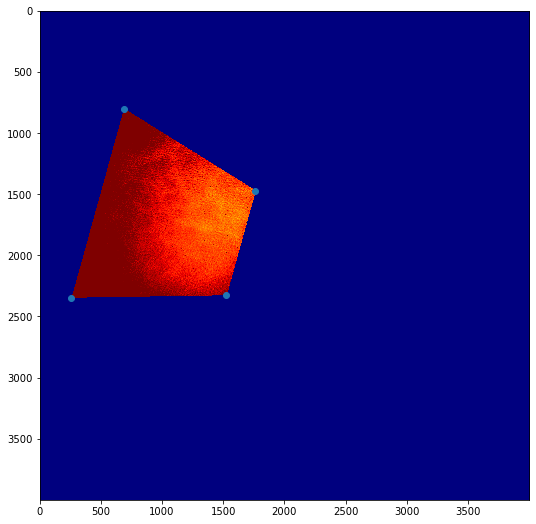

In [59]:
from skimage.transform import resize

for i in range(15):
    
    # form is [x_min, x_max, y_min, y_max]
    top_im_bounds=[-100,100,-100,100]
    
    original_img = plt.imread(sea_img_metadata[i]['image_name'])
    resized_blue = resize(sea_imgs[i,0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    resized_green = resize(sea_imgs[i,1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
    resized_blue[resized_blue < 0] = 0
    resized_green[resized_green < 0] = 0
    
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(resized_blue,cmap='jet', vmin=0.015, vmax=.05)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(resized_green,cmap='jet', vmin=0.035, vmax=.065)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()
    new_name = 'blue_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    new_name = 'green_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    
    break

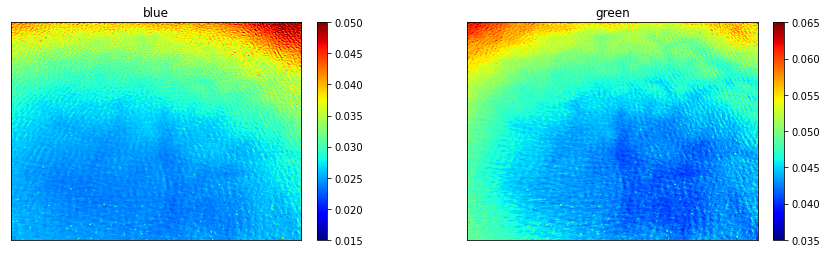

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[-441.6085354  1548.50889259]
 [ -13.56202544    5.02304135]
 [1062.20844904  673.83633639]
 [ 825.06358628 1528.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 2600, 'height': 2400, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.67641673587939,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7144211866928), 'tiled': False, 'interleave': 'band'}
written out as  blue_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!
34.7138816 -76.6757056 47.83 -74.5 0 40
0.05


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


img coords:  [[-441.6085354  1548.50889259]
 [ -13.56202544    5.02304135]
 [1062.20844904  673.83633639]
 [ 825.06358628 1528.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 2600, 'height': 2400, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.67641673587939,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7144211866928), 'tiled': False, 'interleave': 'band'}
written out as  green_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


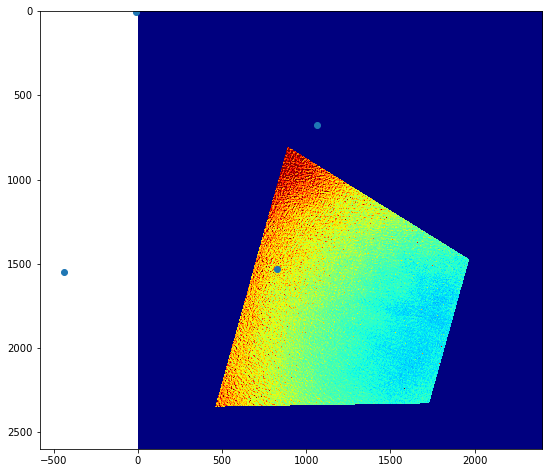

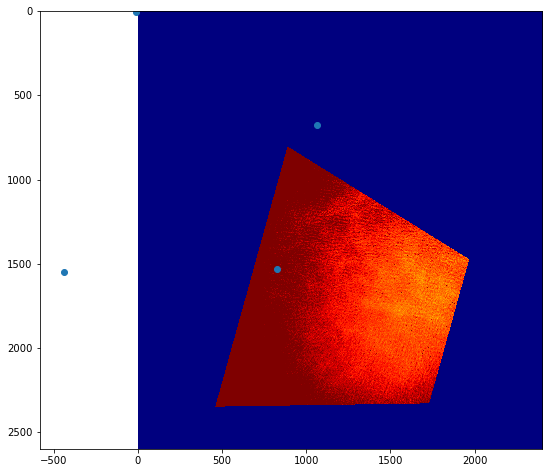

In [58]:
from skimage.transform import resize

for i in range(15):
    
    # form is [x_min, x_max, y_min, y_max]
    top_im_bounds=[-110,10,-30,100]
    x_center_offset = 10 - 110 / 0.05
    
    original_img = plt.imread(sea_img_metadata[i]['image_name'])
    resized_blue = resize(sea_imgs[i,0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    resized_green = resize(sea_imgs[i,1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(resized_blue,cmap='jet', vmin=0.015, vmax=.05)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(resized_green,cmap='jet', vmin=0.035, vmax=.065)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()
    new_name = 'blue_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    new_name = 'green_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    
    break